<a href="https://colab.research.google.com/github/linchen10/WBC-Image/blob/main/HAP618_Final_Project.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

In [ ]:
#Import libraries
import tensorflow as tf
import numpy as np
import matplotlib.pyplot as plt
import os
from tensorflow import keras
from tensorflow.keras.models import Sequential
from tensorflow.keras import layers


In [ ]:
#Load model in
#if loading model in, do not autotune, create model, or train model
model=tf.keras.models.load_model('wbc_model.h5')

In [ ]:
#file paths for data
data_dir='/content/drive/MyDrive/wbc'
test_dir='/content/drive/MyDrive/wbc_test'


In [ ]:
#Load images in
batch_size = 32
image_size = (180,180)
train_ds = tf.keras.utils.image_dataset_from_directory(
    data_dir,
    validation_split = 0.2,
    subset = "training",
    seed = 123,
    image_size = image_size,
    batch_size = batch_size)

val_ds = tf.keras.utils.image_dataset_from_directory(
    data_dir,
    validation_split = 0.2,
    subset = "validation",
    seed = 123,
    image_size = image_size,
    batch_size = batch_size)

test_ds = tf.keras.utils.image_dataset_from_directory(
    test_dir,
    seed = 123,
    image_size = image_size,
    batch_size = batch_size)

class_names=test_ds.class_names
print(class_names)

Found 9798 files belonging to 5 classes.
Using 7839 files for training.
Found 9798 files belonging to 5 classes.
Using 1959 files for validation.
Found 500 files belonging to 5 classes.
['basophil', 'eosinophil', 'lymphocyte', 'monocyte', 'neutrophil']


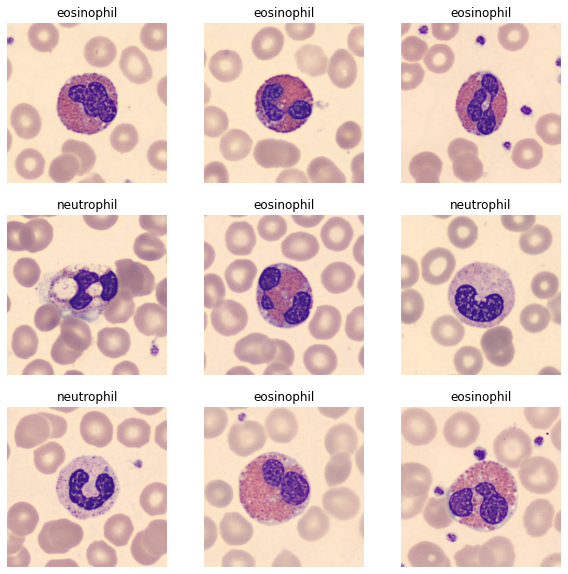

In [ ]:
#Graph Training Data
plt.figure(figsize=(10, 10))
for images, labels in train_ds.take(1):
  for i in range(9):
    ax = plt.subplot(3, 3, i + 1)
    plt.imshow(images[i].numpy().astype("uint8"))
    plt.title(class_names[labels[i]])
    plt.axis("off")

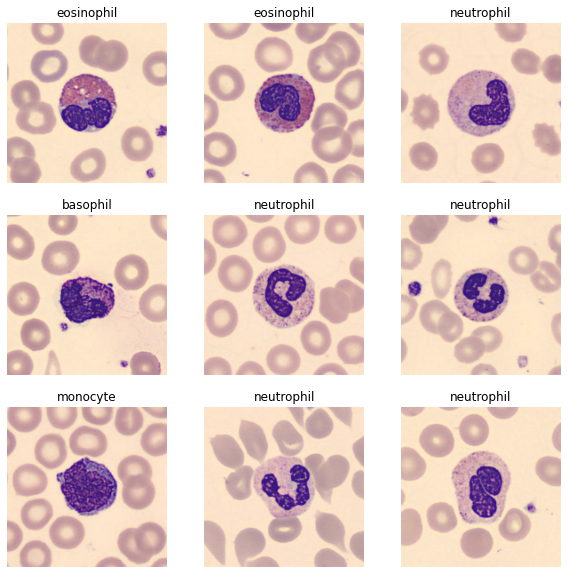

In [ ]:
#Graph Validation Data
plt.figure(figsize=(10, 10))
for images, labels in val_ds.take(1):
  for i in range(9):
    ax = plt.subplot(3, 3, i + 1)
    plt.imshow(images[i].numpy().astype("uint8"))
    plt.title(class_names[labels[i]])
    plt.axis("off")

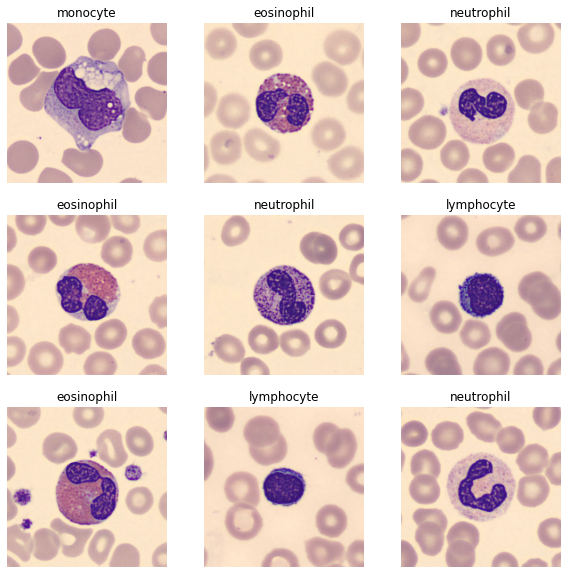

In [ ]:
#Graph Testing Data
plt.figure(figsize=(10, 10))
for images, labels in test_ds.take(1):
  for i in range(9):
    ax = plt.subplot(3,3, i + 1)
    plt.imshow(images[i].numpy().astype("uint8"))
    plt.title(class_names[labels[i]])
    plt.axis("off")

In [ ]:
#Shape of Training Data
for image_batch, labels_batch in train_ds:
  print(image_batch.shape)
  print(labels_batch.shape)
  break

(32, 180, 180, 3)
(32,)


In [ ]:
#Autotune
AUTOTUNE = tf.data.AUTOTUNE
train_ds = train_ds.cache().shuffle(1000).prefetch(buffer_size=AUTOTUNE)
val_ds = val_ds.cache().prefetch(buffer_size=AUTOTUNE)

In [ ]:
#Create model
num_classes = len(class_names)

model = Sequential([
  layers.Rescaling(1./255, input_shape=(image_size[0], image_size[1], 3)),
  layers.Conv2D(16, 3, padding='same', activation='relu'),
  layers.MaxPooling2D(),
  layers.Conv2D(32, 3, padding='same', activation='relu'),
  layers.MaxPooling2D(),
  layers.Conv2D(64, 3, padding='same', activation='relu'),
  layers.MaxPooling2D(),
  layers.Flatten(),
  layers.Dense(128, activation='relu'),
  layers.Dense(num_classes)
])

In [ ]:
#Compile model and display summary
model.compile(optimizer = 'adam',
              loss = tf.keras.losses.SparseCategoricalCrossentropy(from_logits=True),
              metrics=['accuracy'])
model.summary()

Model: "sequential"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 rescaling (Rescaling)       (None, 180, 180, 3)       0         
                                                                 
 conv2d (Conv2D)             (None, 180, 180, 16)      448       
                                                                 
 max_pooling2d (MaxPooling2D  (None, 90, 90, 16)       0         
 )                                                               
                                                                 
 conv2d_1 (Conv2D)           (None, 90, 90, 32)        4640      
                                                                 
 max_pooling2d_1 (MaxPooling  (None, 45, 45, 32)       0         
 2D)                                                             
                                                                 
 conv2d_2 (Conv2D)           (None, 45, 45, 64)        1

In [ ]:
#Train model with 10 epochs
epochs=10
history = model.fit(
  train_ds,
  validation_data=val_ds,
  epochs=epochs
)

Epoch 1/10
245/245 [==============================] - 1727s 2s/step - loss: 0.8760 - accuracy: 0.6718 - val_loss: 0.2474 - val_accuracy: 0.9311
Epoch 2/10
245/245 [==============================] - 237s 969ms/step - loss: 0.1892 - accuracy: 0.9432 - val_loss: 0.1149 - val_accuracy: 0.9719
Epoch 3/10
245/245 [==============================] - 237s 969ms/step - loss: 0.1090 - accuracy: 0.9663 - val_loss: 0.1326 - val_accuracy: 0.9581
Epoch 4/10
245/245 [==============================] - 236s 965ms/step - loss: 0.0917 - accuracy: 0.9695 - val_loss: 0.0846 - val_accuracy: 0.9770
Epoch 5/10
245/245 [==============================] - 236s 966ms/step - loss: 0.0773 - accuracy: 0.9751 - val_loss: 0.0940 - val_accuracy: 0.9719
Epoch 6/10
245/245 [==============================] - 236s 965ms/step - loss: 0.0558 - accuracy: 0.9812 - val_loss: 0.1266 - val_accuracy: 0.9602
Epoch 7/10
245/245 [==============================] - 236s 965ms/step - loss: 0.0364 - accuracy: 0.9876 - val_loss: 0.0875 - v

In [ ]:
#Save model
model.save('wbc_model.h5')

In [ ]:
#Evaluate model on test dataset
test_loss, test_accuracy = model.evaluate(test_ds)
print('Test loss: ', test_loss)
print('Test accuracy: ', test_accuracy)

16/16 [==============================] - 5s 291ms/step - loss: 0.0891 - accuracy: 0.9720
Test loss:  0.08911952376365662
Test accuracy:  0.972000002861023


In [ ]:
#Predict 1 image with file path
def predict_1wbc(dir):
  img = tf.keras.preprocessing.image.load_img(dir, target_size = (image_size[0],image_size[1]))
  plt.imshow(img)
  img = tf.keras.preprocessing.image.img_to_array(img)
  img = np.expand_dims(img,axis=0)
  prediction = model.predict(img)
  print('Prediction:',class_names[np.argmax(prediction)])

#Predict multiple images in one directory
def wbc_test(dir):
  baso=0
  eos=0
  lymph=0
  mono=0
  neut=0
  for j in os.listdir(dir):
    img = tf.keras.preprocessing.image.load_img(dir+ '//' + j, target_size = (image_size[0],image_size[1]))
    plt.imshow(img)
    plt.show()
    img1 = tf.keras.preprocessing.image.img_to_array(img)
    img1 = np.expand_dims(img1,axis=0)
    imgs = np.vstack([img1])
    prediction = model.predict(imgs)
    prediction = np.argmax(prediction)
    if prediction == 0:
      baso +=1
    elif prediction == 1:
      eos +=1
    elif prediction == 2:
      lymph +=1
    elif prediction ==3:
      mono +=1
    elif prediction == 4:
      neut+=1
    print('Prediction:',class_names[(prediction)])
  print('Basophil:',baso)
  print('Eosinophil:',eos)
  print('Lymphocyte:',lymph)
  print('Monocyte:',mono)
  print('Neutrophil',neut)

baso_test_1 = '/content/drive/MyDrive/wbc_test/basophil/BA_1581.jpg'
eos_test_1 = '/content/drive/MyDrive/wbc_test/eosinophil/EO_10690.jpg'
neut_test_1 = '/content/drive/MyDrive/wbc_test/neutrophil/BNE_14932.jpg'
mono_test_1 = '/content/drive/MyDrive/wbc_test/monocyte/MO_12960.jpg'
lymph_test_1 = '/content/drive/MyDrive/wbc_test/lymphocyte/LY_14139.jpg'

baso_test = '/content/drive/MyDrive/wbc_test/basophil'
eos_test = '/content/drive/MyDrive/wbc_test/eosinophil'
neut_test = '/content/drive/MyDrive/wbc_test/neutrophil'
mono_test = '/content/drive/MyDrive/wbc_test/monocyte'
lymph_test = '/content/drive/MyDrive/wbc_test/lymphocyte'

Prediction: basophil


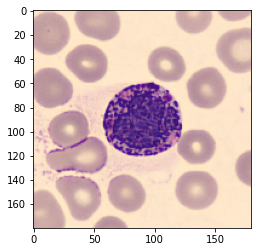

In [ ]:
#Predict 1 basophil
predict_1wbc(baso_test_1)

Prediction: eosinophil


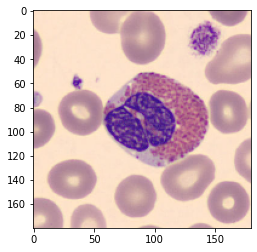

In [ ]:
#Predict 1 eosinophil
predict_1wbc(eos_test_1)

Prediction: lymphocyte


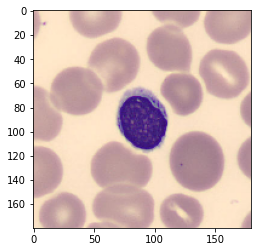

In [ ]:
#Predict 1 lymphocyte
predict_1wbc(lymph_test_1)

Prediction: monocyte


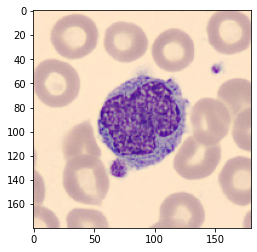

In [ ]:
#Predict 1 monocyte
predict_1wbc(mono_test_1)

Prediction: neutrophil


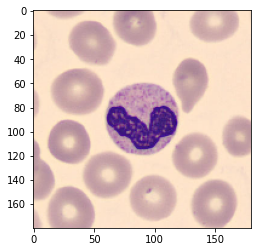

In [ ]:
predict_1wbc(neut_test_1)

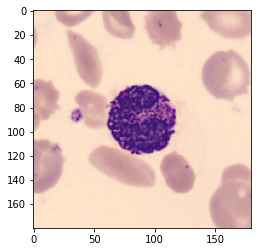

Prediction: basophil


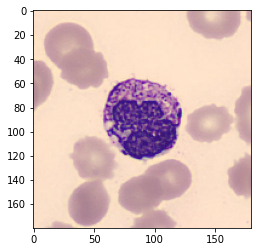

Prediction: basophil


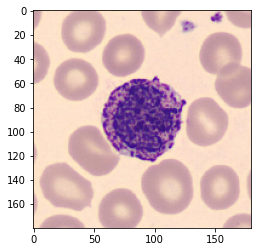

Prediction: basophil


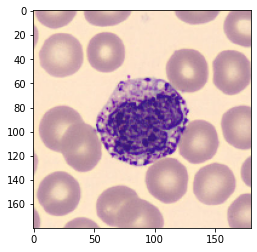

Prediction: basophil


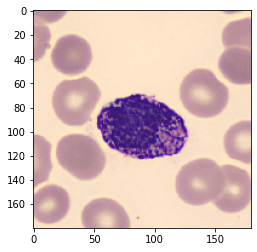

Prediction: basophil


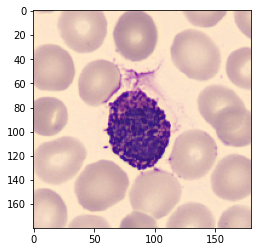

Prediction: basophil


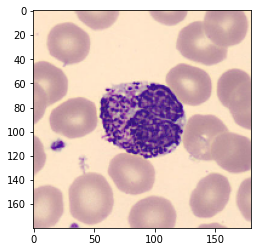

Prediction: basophil


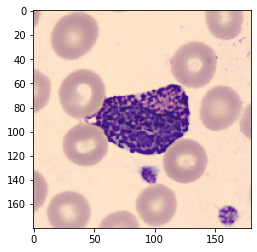

Prediction: basophil


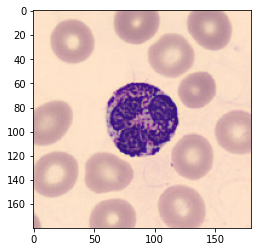

Prediction: basophil


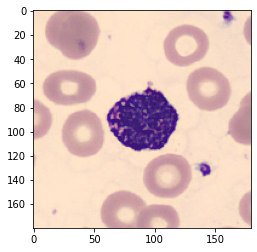

Prediction: basophil


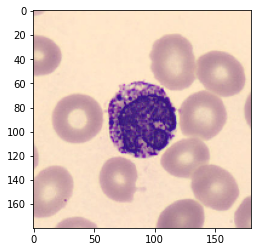

Prediction: basophil


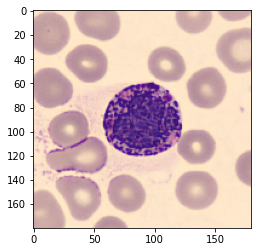

Prediction: basophil


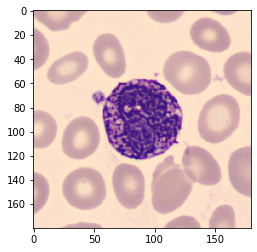

Prediction: basophil


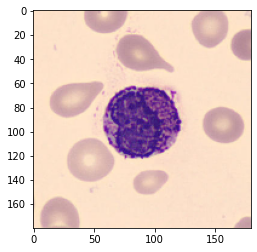

Prediction: basophil


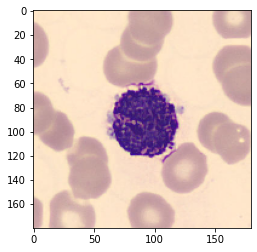

Prediction: basophil


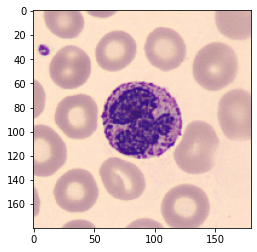

Prediction: basophil


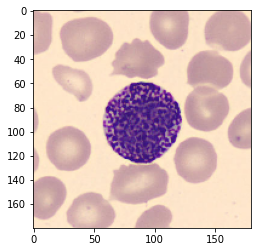

Prediction: basophil


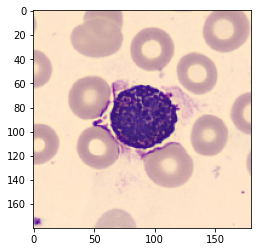

Prediction: basophil


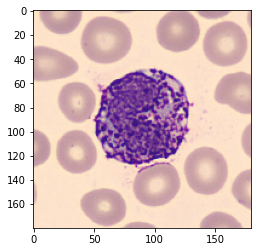

Prediction: basophil


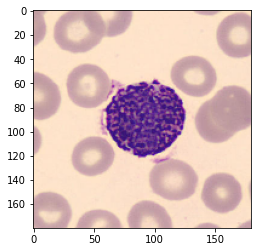

Prediction: basophil


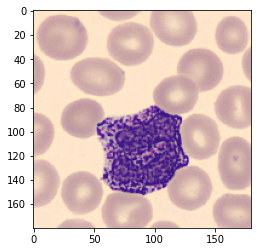

Prediction: basophil


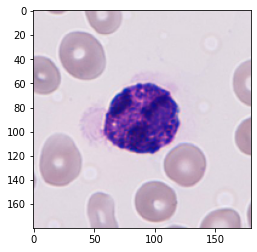

Prediction: basophil


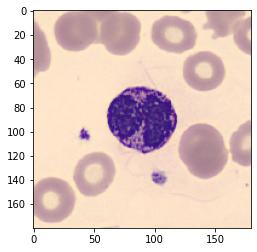

Prediction: basophil


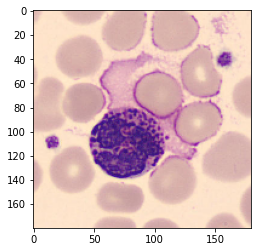

Prediction: basophil


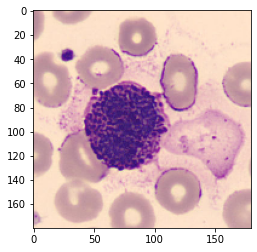

Prediction: basophil


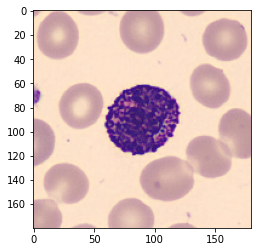

Prediction: basophil


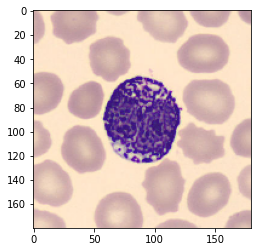

Prediction: basophil


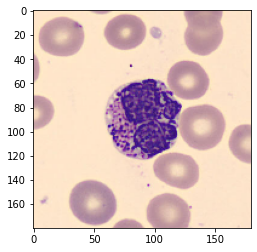

Prediction: basophil


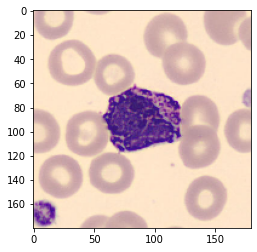

Prediction: basophil


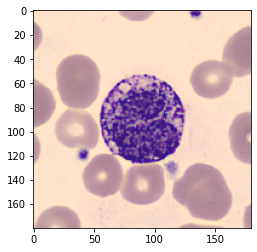

Prediction: basophil


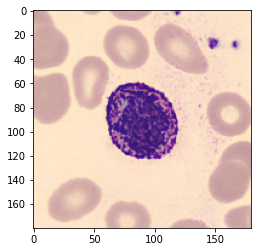

Prediction: basophil


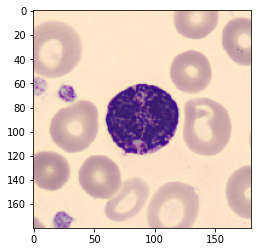

Prediction: basophil


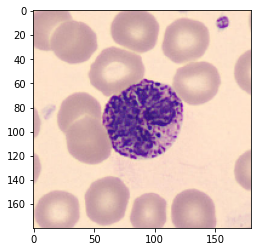

Prediction: basophil


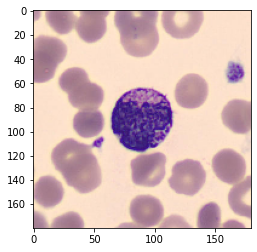

Prediction: basophil


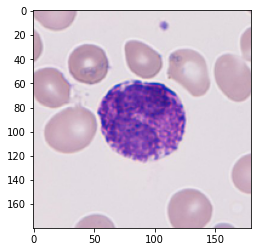

Prediction: basophil


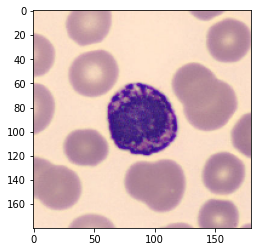

Prediction: basophil


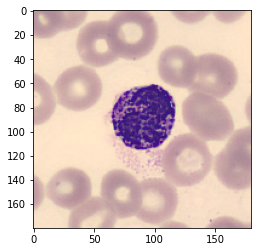

Prediction: basophil


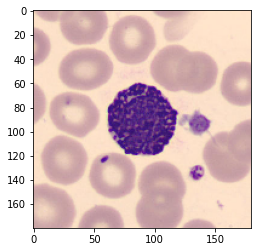

Prediction: basophil


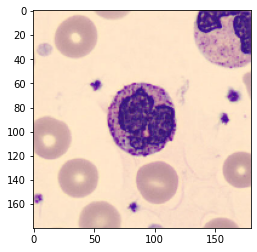

Prediction: eosinophil


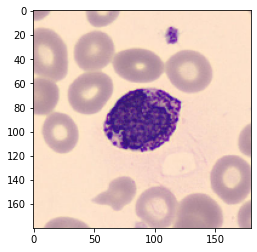

Prediction: basophil


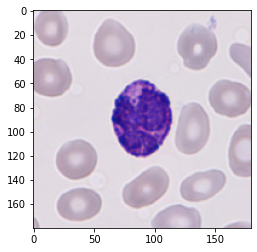

Prediction: basophil


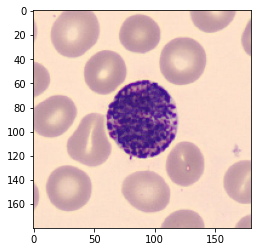

Prediction: basophil


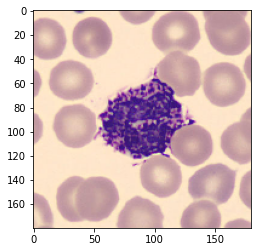

Prediction: basophil


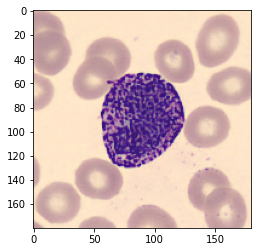

Prediction: basophil


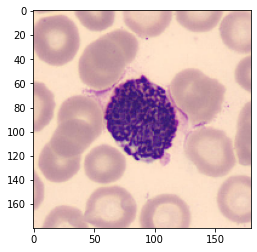

Prediction: basophil


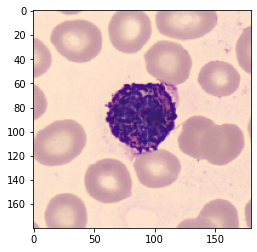

Prediction: basophil


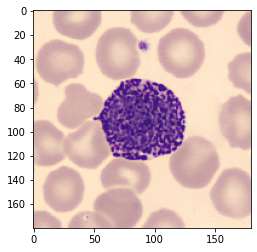

Prediction: basophil


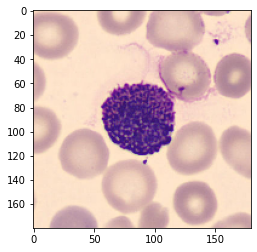

Prediction: basophil


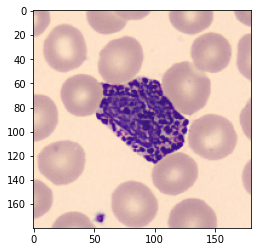

Prediction: basophil


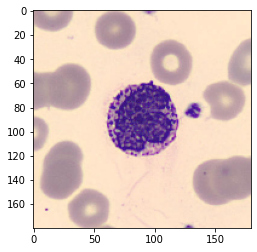

Prediction: basophil


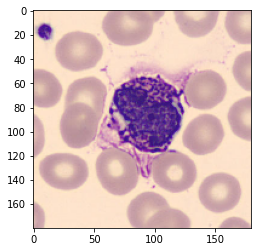

Prediction: basophil


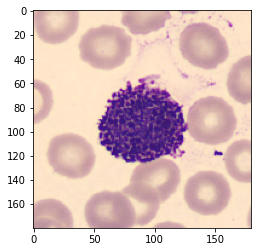

Prediction: basophil


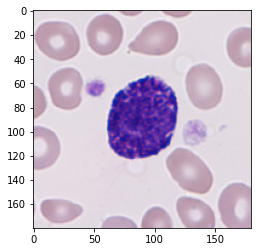

Prediction: basophil


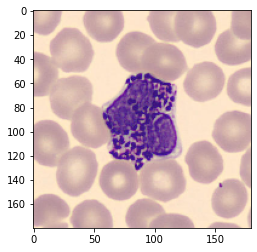

Prediction: basophil


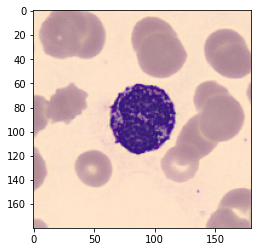

Prediction: basophil


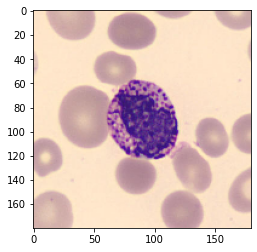

Prediction: basophil


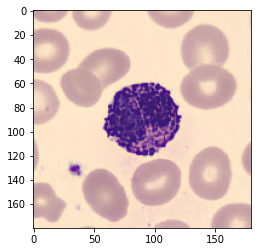

Prediction: basophil


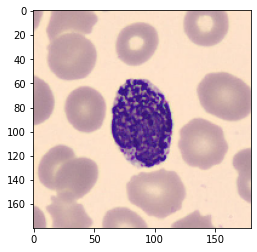

Prediction: basophil


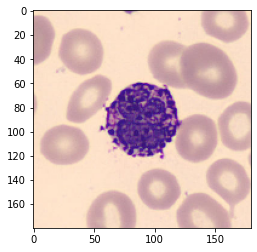

Prediction: basophil


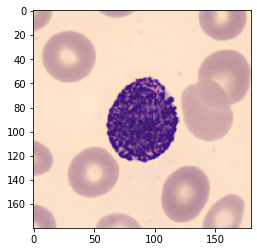

Prediction: basophil


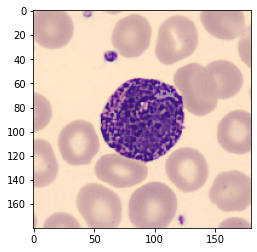

Prediction: basophil


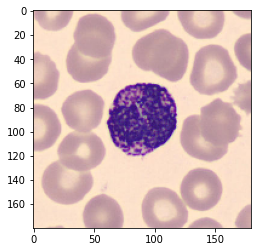

Prediction: basophil


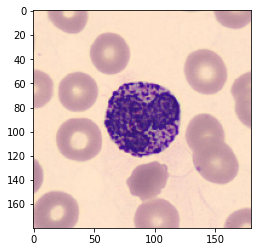

Prediction: basophil


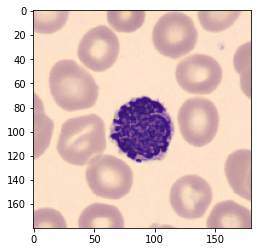

Prediction: lymphocyte


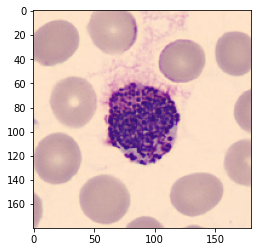

Prediction: basophil


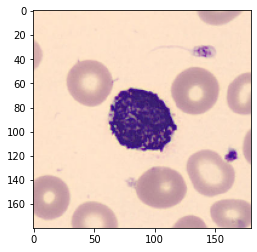

Prediction: basophil


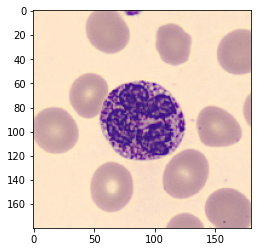

Prediction: basophil


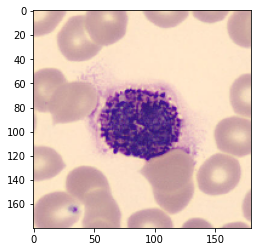

Prediction: basophil


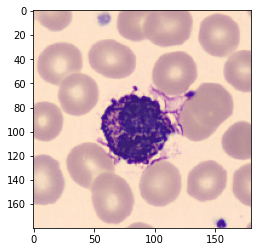

Prediction: basophil


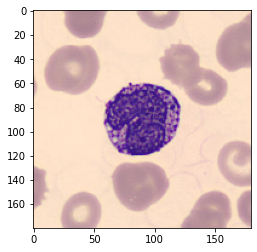

Prediction: basophil


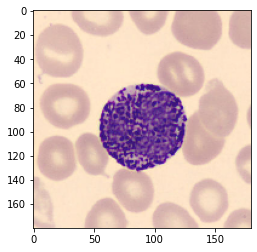

Prediction: basophil


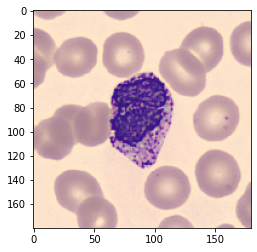

Prediction: basophil


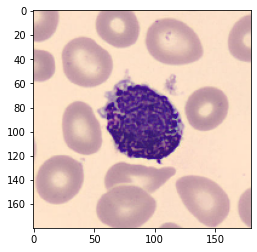

Prediction: basophil


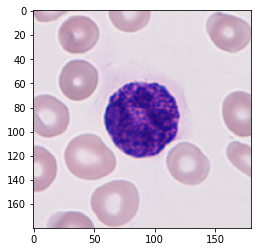

Prediction: basophil


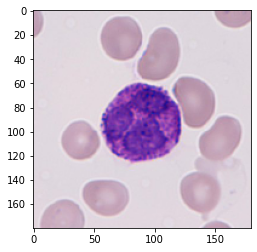

Prediction: basophil


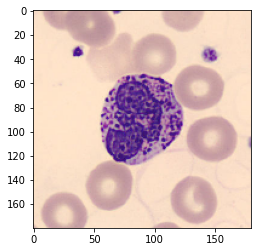

Prediction: basophil


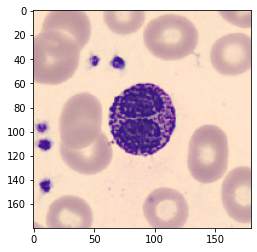

Prediction: basophil


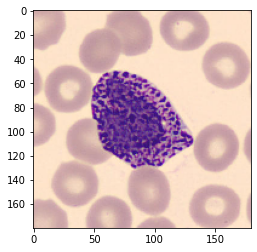

Prediction: basophil


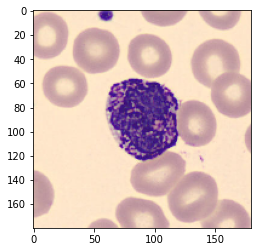

Prediction: basophil


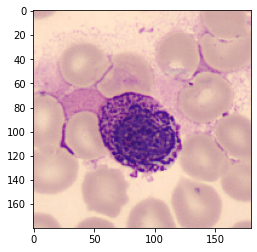

Prediction: basophil


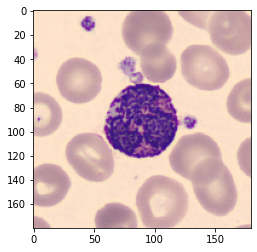

Prediction: basophil


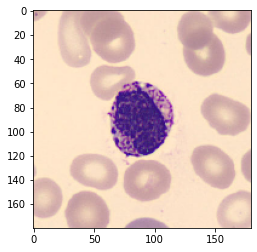

Prediction: basophil


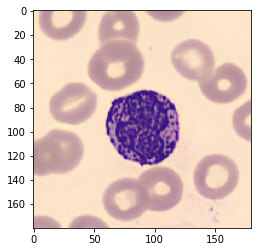

Prediction: basophil


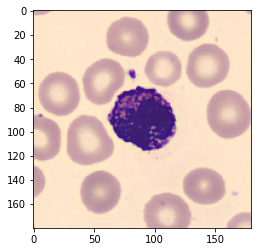

Prediction: basophil


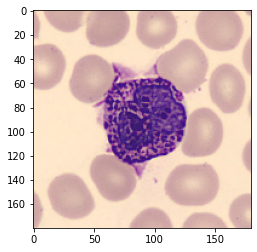

Prediction: basophil


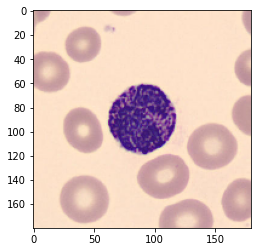

Prediction: basophil


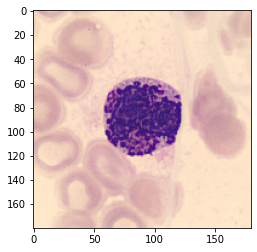

Prediction: basophil


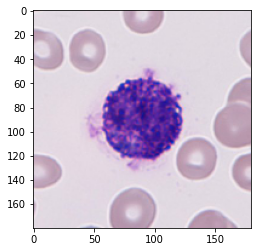

Prediction: basophil


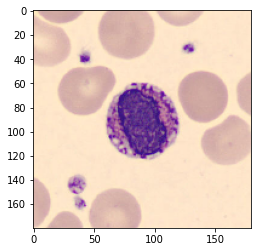

Prediction: basophil


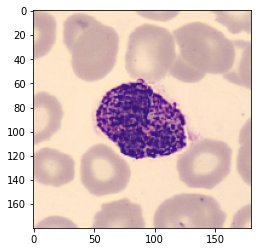

Prediction: basophil


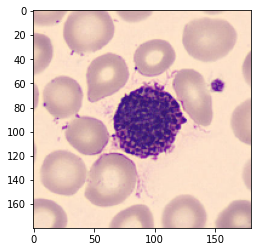

Prediction: basophil


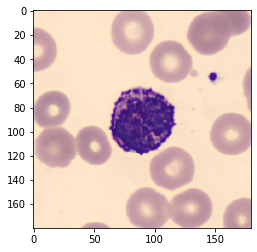

Prediction: basophil


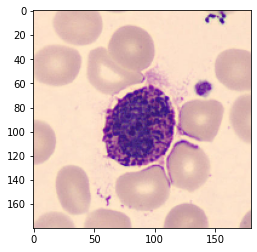

Prediction: basophil


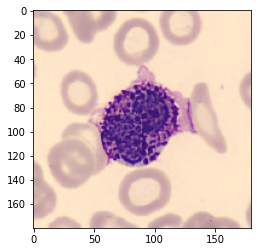

Prediction: basophil


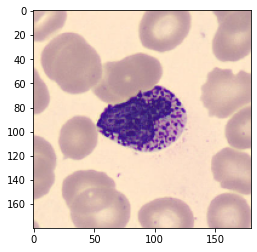

Prediction: basophil


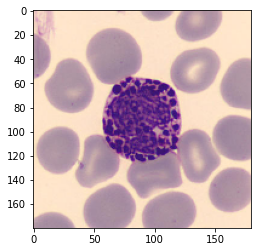

Prediction: basophil


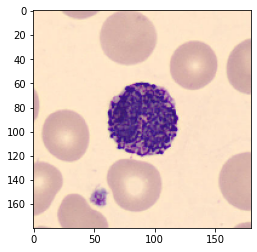

Prediction: basophil


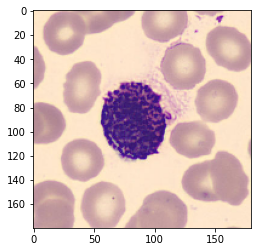

Prediction: basophil


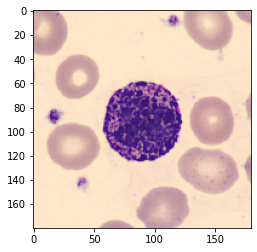

Prediction: basophil


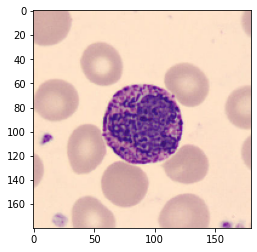

Prediction: basophil
Basophil: 98
Eosinophil: 1
Lymphocyte: 1
Monocyte: 0
Neutrophil 0


In [ ]:
wbc_test(baso_test)

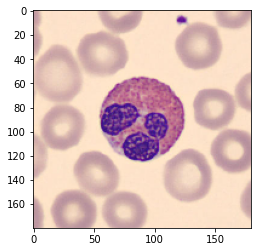

Prediction: eosinophil


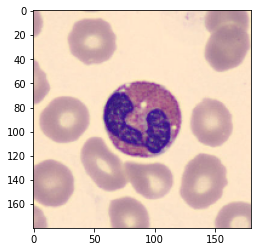

Prediction: eosinophil


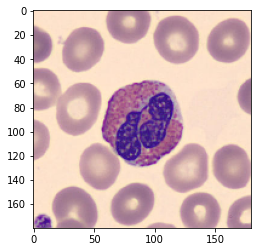

Prediction: eosinophil


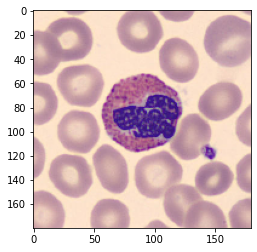

Prediction: eosinophil


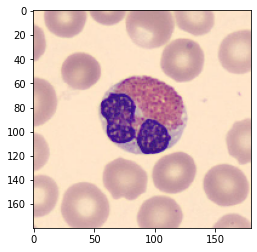

Prediction: eosinophil


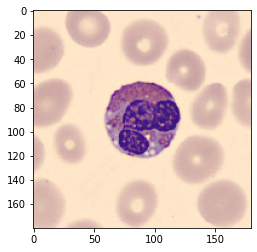

Prediction: eosinophil


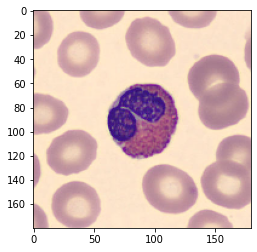

Prediction: eosinophil


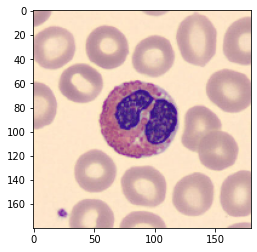

Prediction: eosinophil


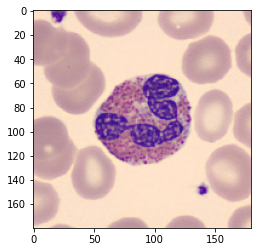

Prediction: eosinophil


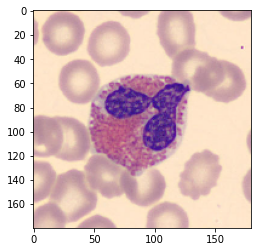

Prediction: eosinophil


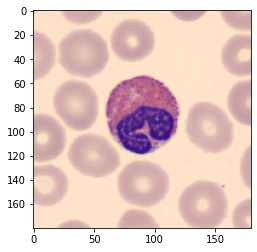

Prediction: eosinophil


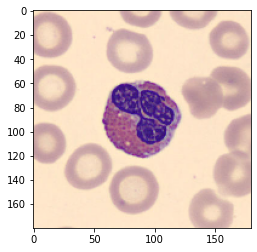

Prediction: eosinophil


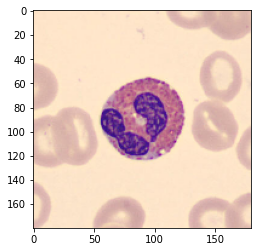

Prediction: eosinophil


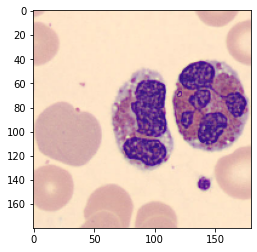

Prediction: eosinophil


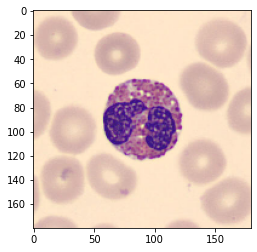

Prediction: eosinophil


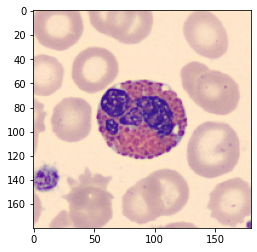

Prediction: eosinophil


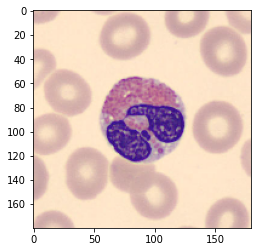

Prediction: eosinophil


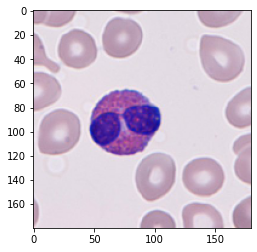

Prediction: eosinophil


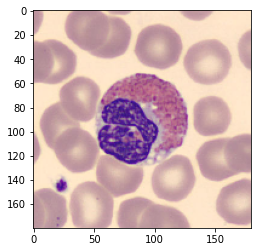

Prediction: eosinophil


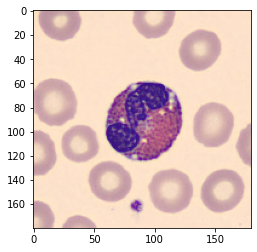

Prediction: eosinophil


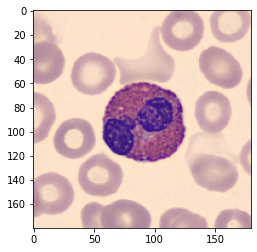

Prediction: eosinophil


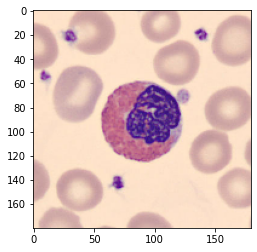

Prediction: eosinophil


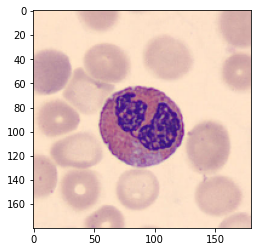

Prediction: eosinophil


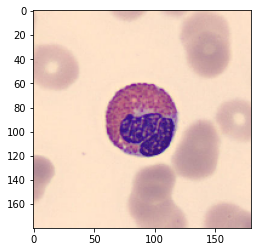

Prediction: eosinophil


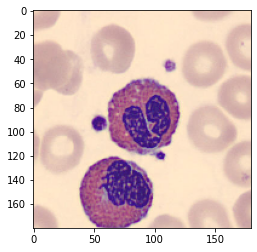

Prediction: eosinophil


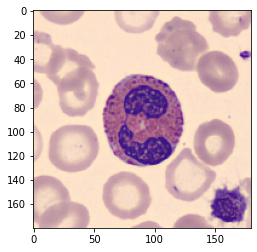

Prediction: eosinophil


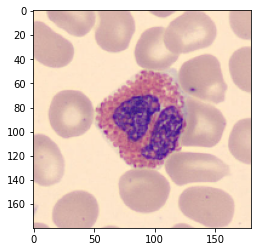

Prediction: eosinophil


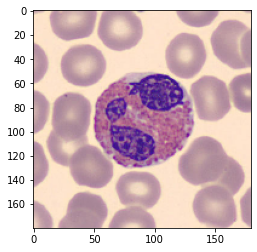

Prediction: eosinophil


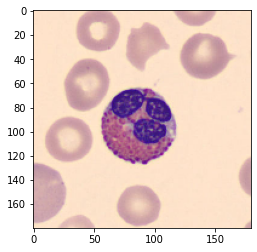

Prediction: eosinophil


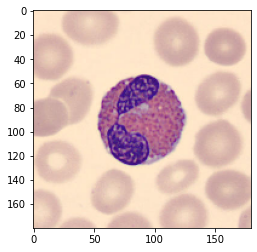

Prediction: eosinophil


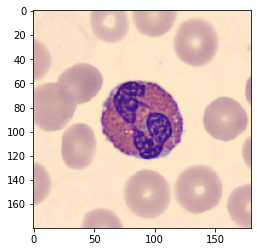

Prediction: eosinophil


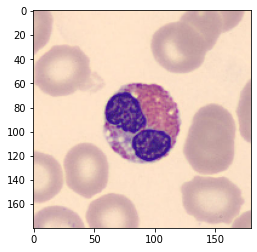

Prediction: eosinophil


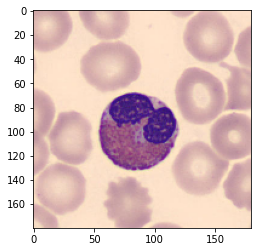

Prediction: eosinophil


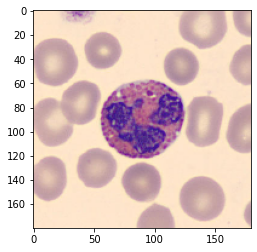

Prediction: eosinophil


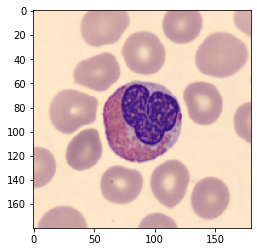

Prediction: eosinophil


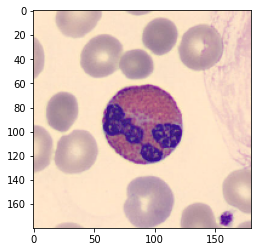

Prediction: eosinophil


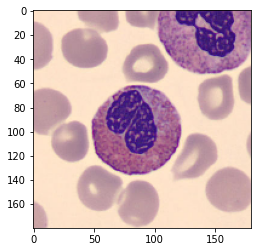

Prediction: eosinophil


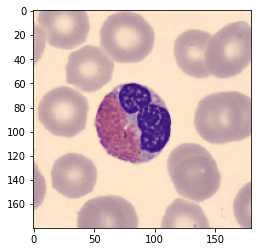

Prediction: eosinophil


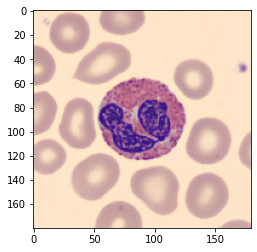

Prediction: eosinophil


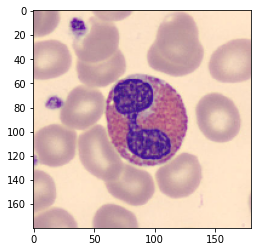

Prediction: eosinophil


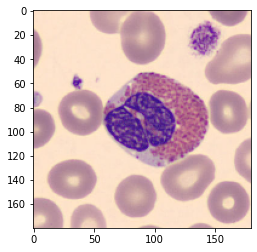

Prediction: eosinophil


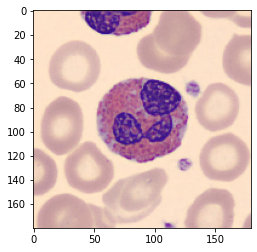

Prediction: eosinophil


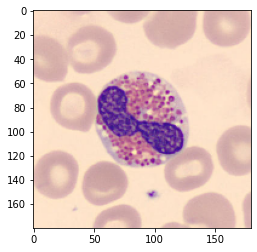

Prediction: eosinophil


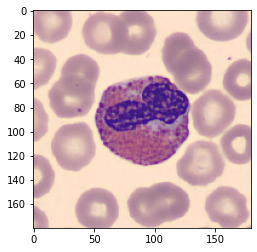

Prediction: eosinophil


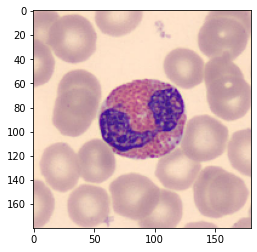

Prediction: eosinophil


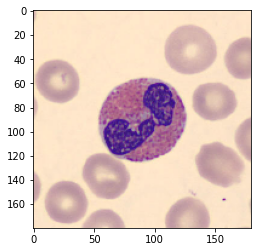

Prediction: eosinophil


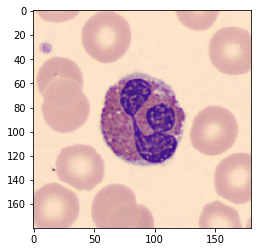

Prediction: eosinophil


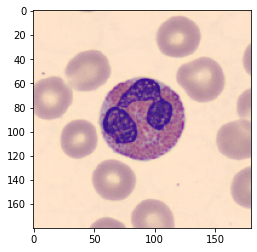

Prediction: eosinophil


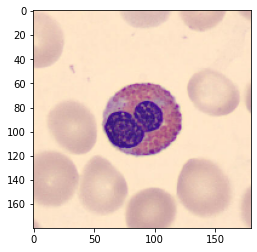

Prediction: eosinophil


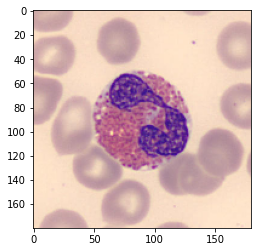

Prediction: eosinophil


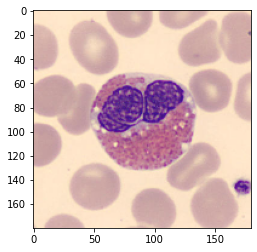

Prediction: eosinophil


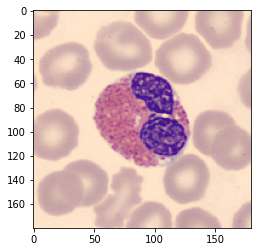

Prediction: eosinophil


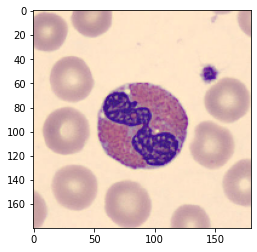

Prediction: eosinophil


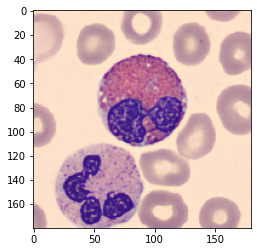

Prediction: eosinophil


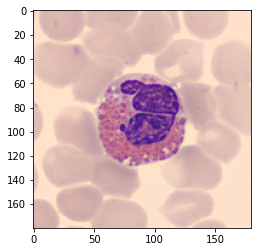

Prediction: eosinophil


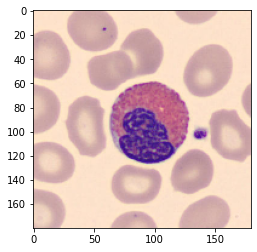

Prediction: eosinophil


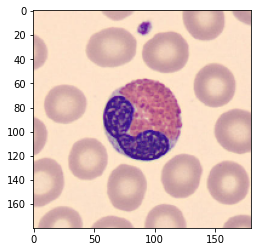

Prediction: eosinophil


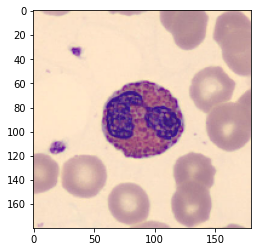

Prediction: eosinophil


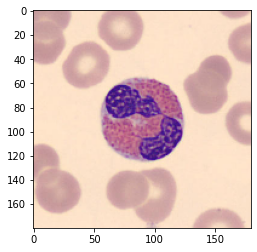

Prediction: eosinophil


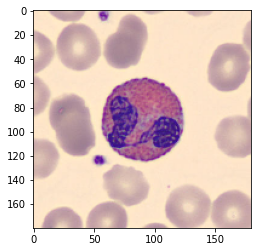

Prediction: eosinophil


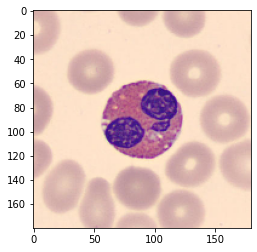

Prediction: eosinophil


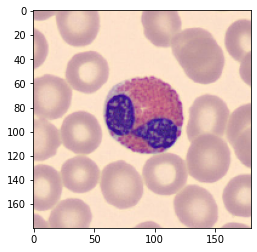

Prediction: eosinophil


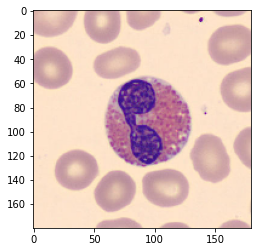

Prediction: eosinophil


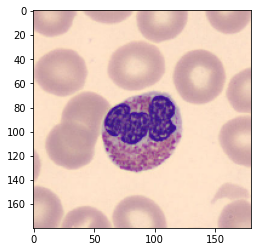

Prediction: eosinophil


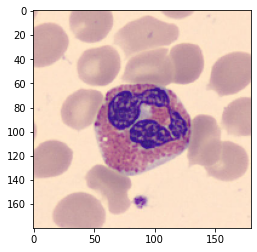

Prediction: eosinophil


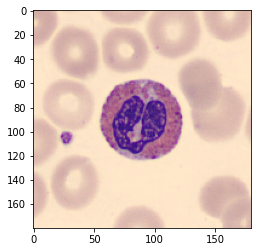

Prediction: eosinophil


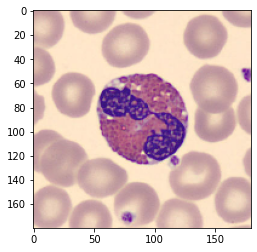

Prediction: eosinophil


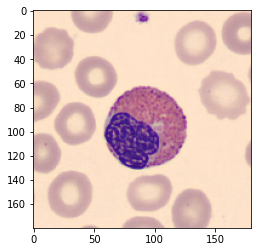

Prediction: eosinophil


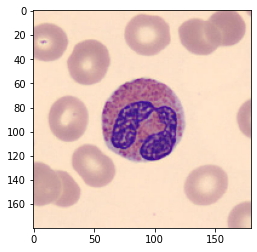

Prediction: eosinophil


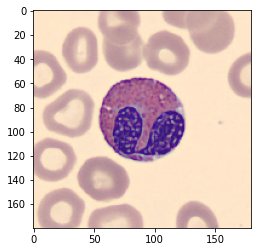

Prediction: eosinophil


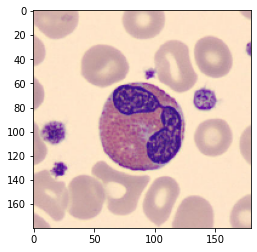

Prediction: eosinophil


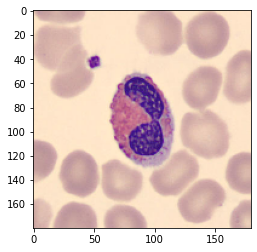

Prediction: eosinophil


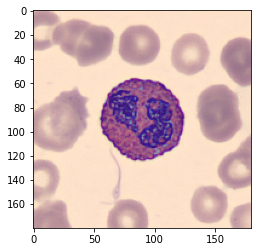

Prediction: eosinophil


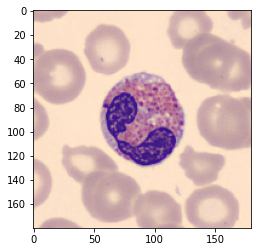

Prediction: eosinophil


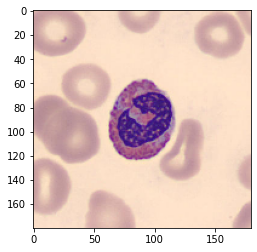

Prediction: eosinophil


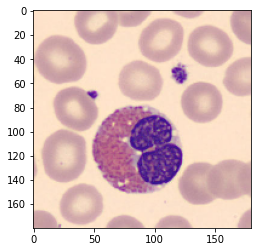

Prediction: eosinophil


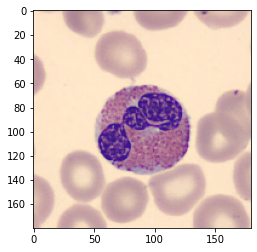

Prediction: eosinophil


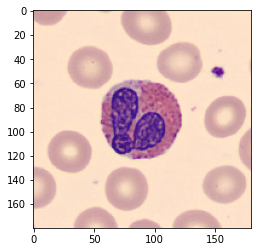

Prediction: eosinophil


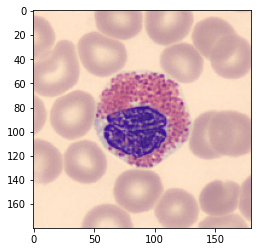

Prediction: eosinophil


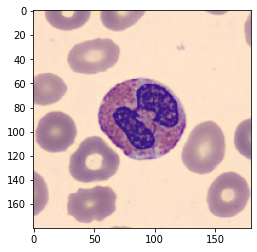

Prediction: eosinophil


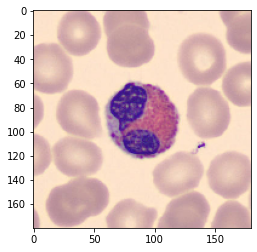

Prediction: eosinophil


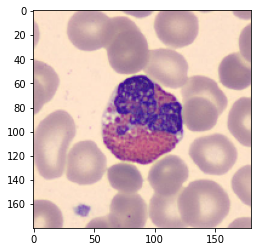

Prediction: eosinophil


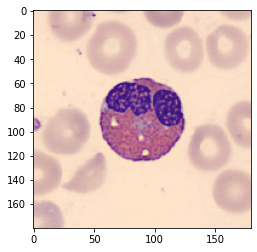

Prediction: eosinophil


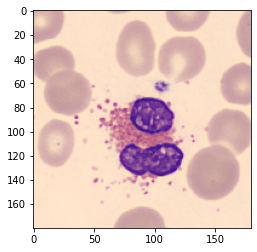

Prediction: eosinophil


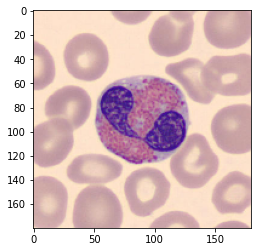

Prediction: eosinophil


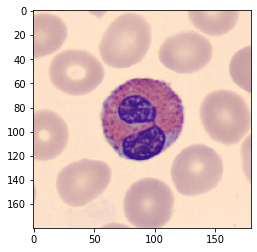

Prediction: eosinophil


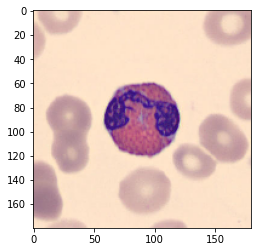

Prediction: eosinophil


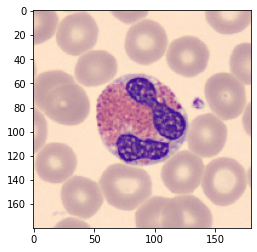

Prediction: eosinophil


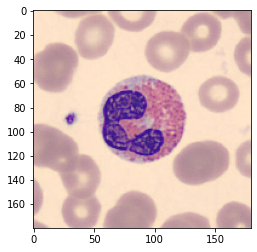

Prediction: eosinophil


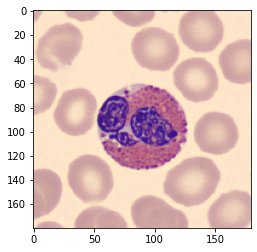

Prediction: eosinophil


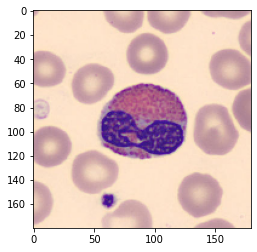

Prediction: eosinophil


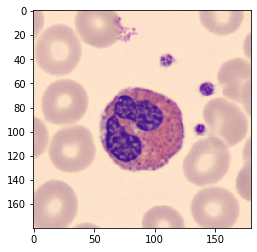

Prediction: eosinophil


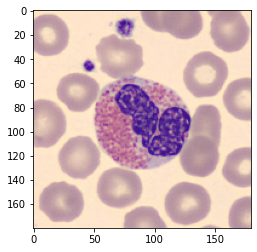

Prediction: eosinophil


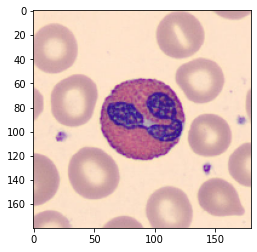

Prediction: eosinophil


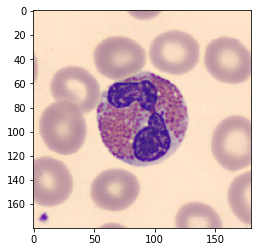

Prediction: eosinophil


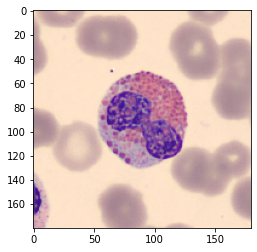

Prediction: eosinophil


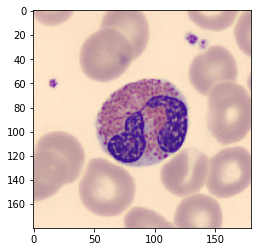

Prediction: eosinophil


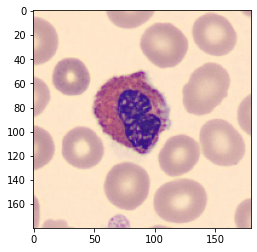

Prediction: eosinophil


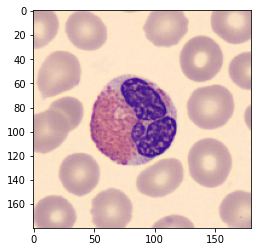

Prediction: eosinophil


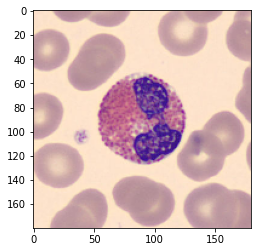

Prediction: eosinophil
Basophil: 0
Eosinophil: 100
Lymphocyte: 0
Monocyte: 0
Neutrophil 0


In [ ]:
wbc_test(eos_test)


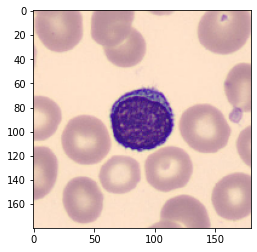

Prediction: lymphocyte


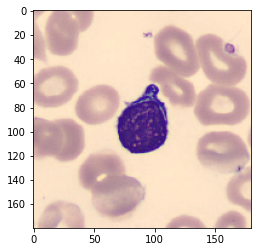

Prediction: lymphocyte


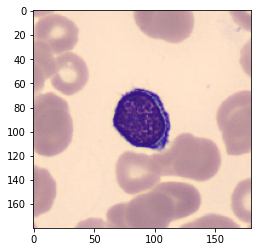

Prediction: lymphocyte


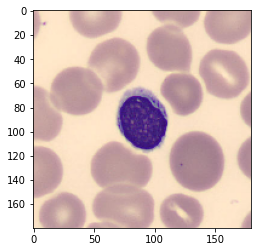

Prediction: lymphocyte


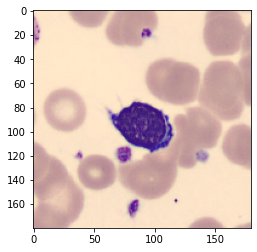

Prediction: lymphocyte


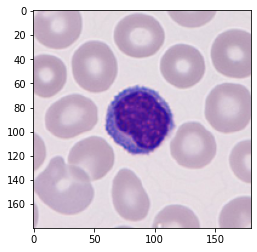

Prediction: lymphocyte


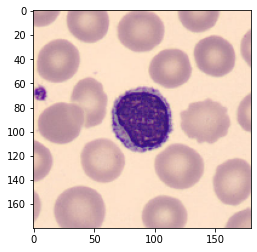

Prediction: lymphocyte


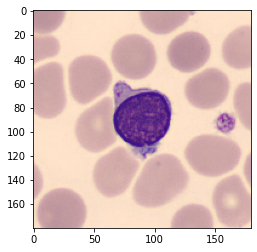

Prediction: lymphocyte


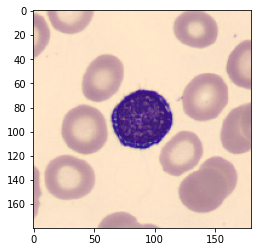

Prediction: lymphocyte


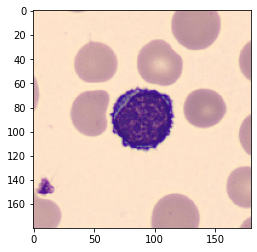

Prediction: lymphocyte


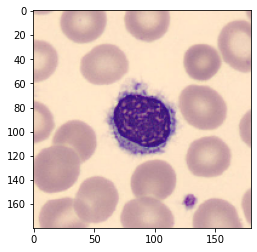

Prediction: lymphocyte


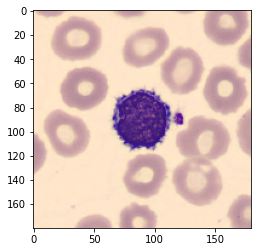

Prediction: lymphocyte


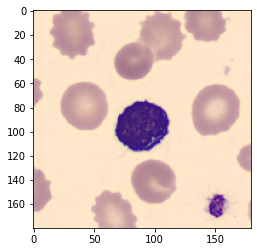

Prediction: lymphocyte


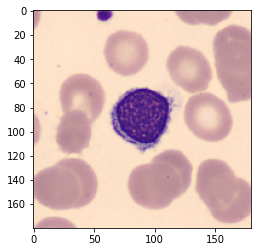

Prediction: lymphocyte


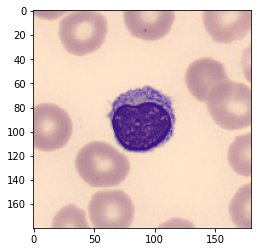

Prediction: lymphocyte


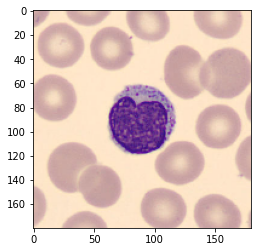

Prediction: lymphocyte


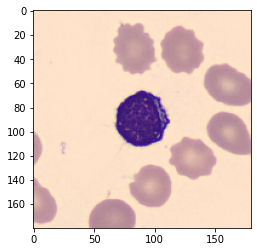

Prediction: lymphocyte


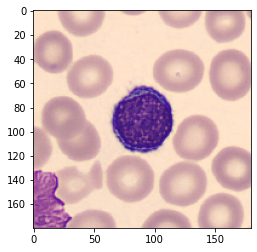

Prediction: lymphocyte


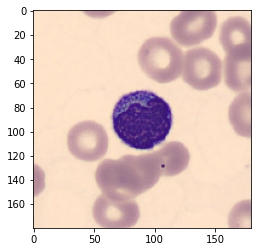

Prediction: lymphocyte


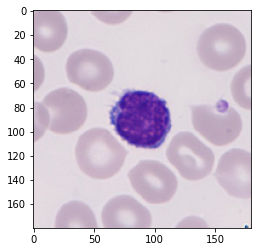

Prediction: lymphocyte


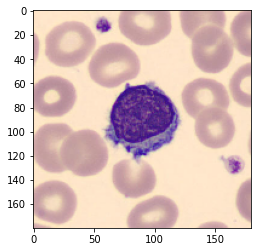

Prediction: lymphocyte


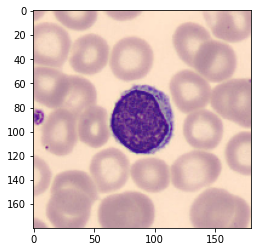

Prediction: lymphocyte


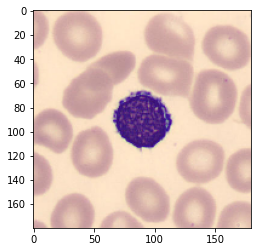

Prediction: lymphocyte


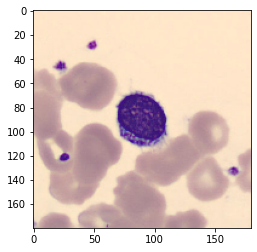

Prediction: lymphocyte


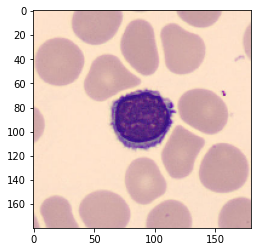

Prediction: lymphocyte


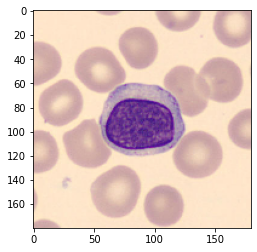

Prediction: lymphocyte


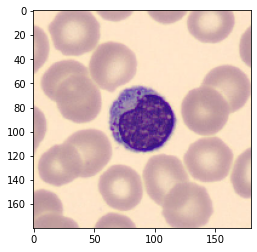

Prediction: lymphocyte


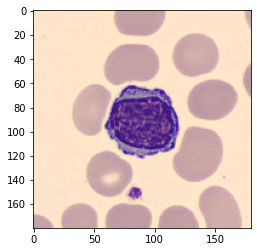

Prediction: monocyte


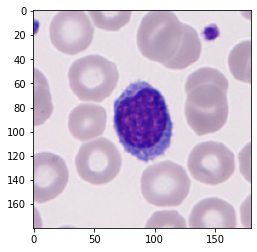

Prediction: lymphocyte


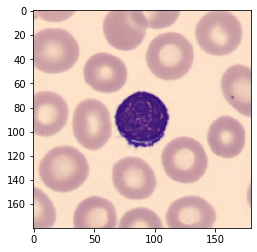

Prediction: lymphocyte


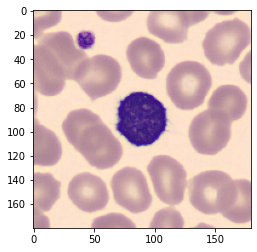

Prediction: lymphocyte


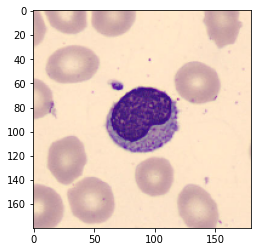

Prediction: lymphocyte


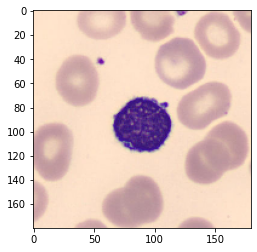

Prediction: lymphocyte


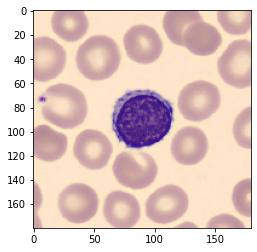

Prediction: lymphocyte


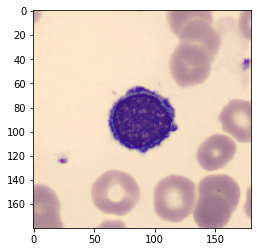

Prediction: lymphocyte


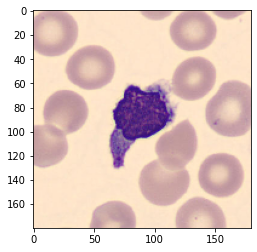

Prediction: lymphocyte


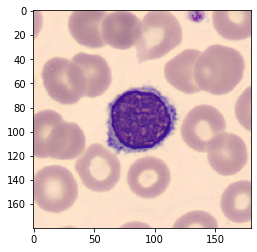

Prediction: lymphocyte


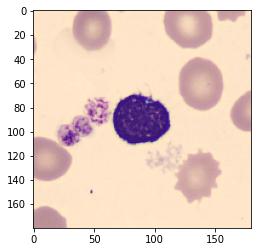

Prediction: lymphocyte


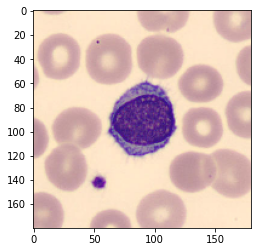

Prediction: lymphocyte


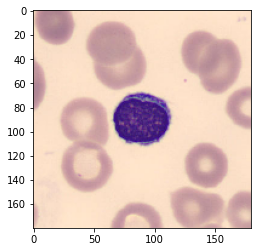

Prediction: lymphocyte


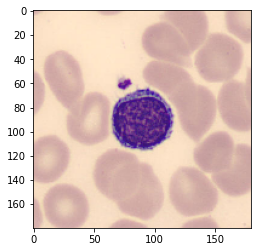

Prediction: lymphocyte


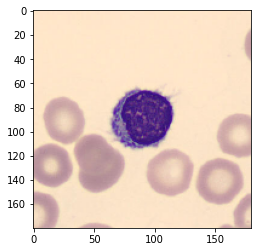

Prediction: lymphocyte


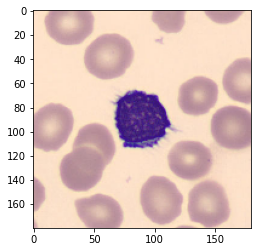

Prediction: lymphocyte


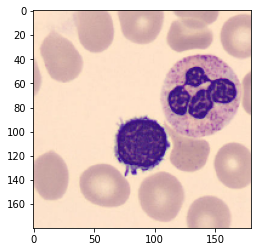

Prediction: basophil


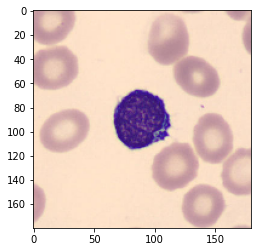

Prediction: lymphocyte


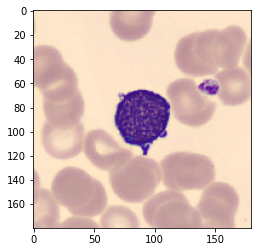

Prediction: lymphocyte


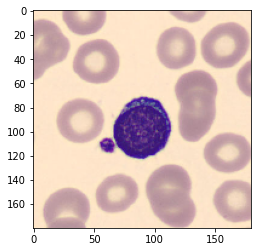

Prediction: lymphocyte


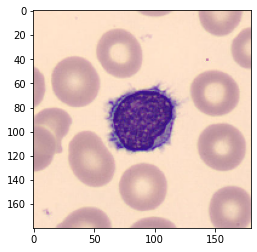

Prediction: lymphocyte


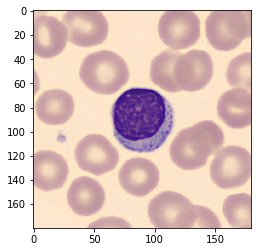

Prediction: lymphocyte


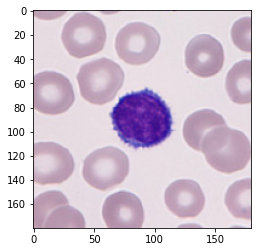

Prediction: lymphocyte


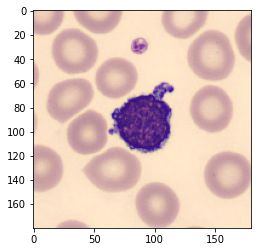

Prediction: lymphocyte


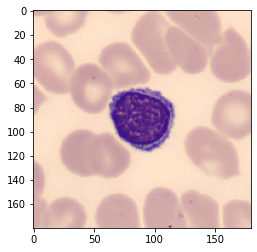

Prediction: lymphocyte


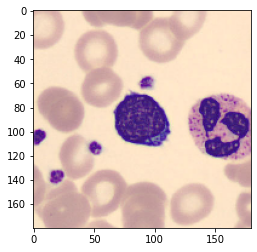

Prediction: lymphocyte


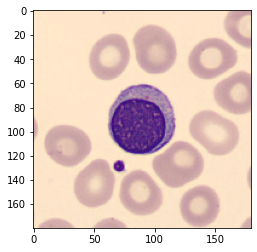

Prediction: lymphocyte


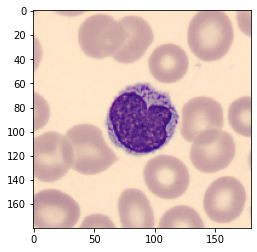

Prediction: lymphocyte


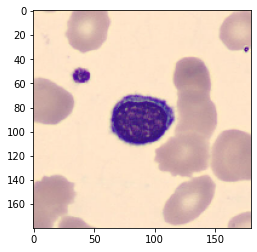

Prediction: lymphocyte


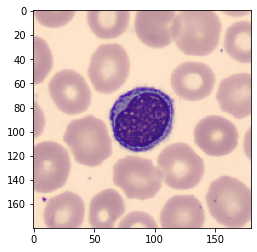

Prediction: lymphocyte


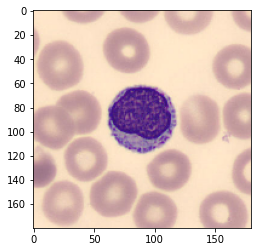

Prediction: lymphocyte


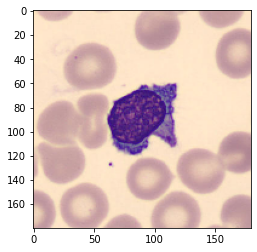

Prediction: lymphocyte


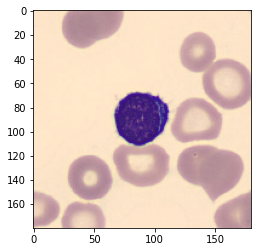

Prediction: lymphocyte


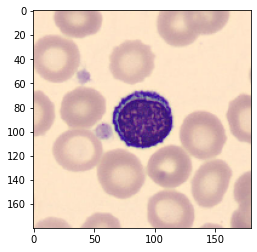

Prediction: lymphocyte


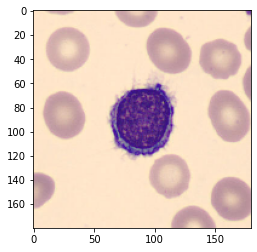

Prediction: lymphocyte


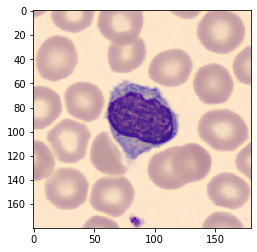

Prediction: lymphocyte


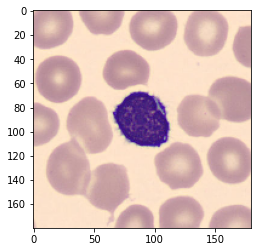

Prediction: lymphocyte


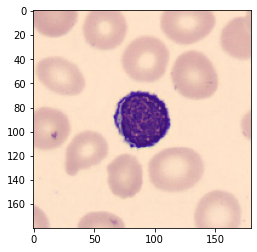

Prediction: lymphocyte


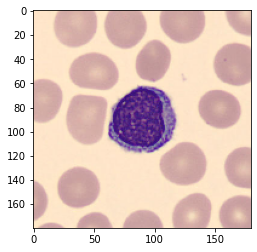

Prediction: lymphocyte


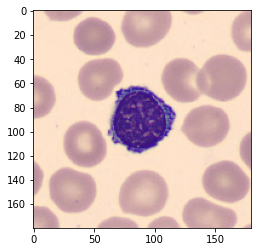

Prediction: lymphocyte


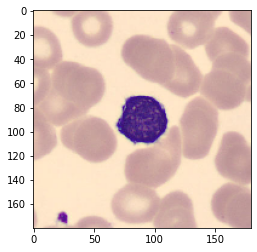

Prediction: lymphocyte


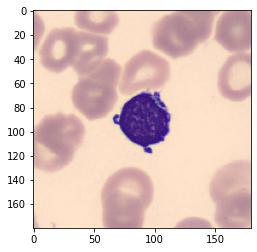

Prediction: lymphocyte


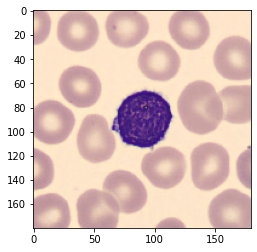

Prediction: lymphocyte


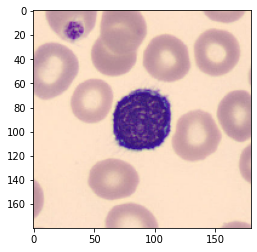

Prediction: lymphocyte


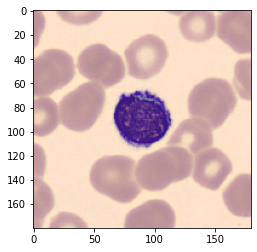

Prediction: lymphocyte


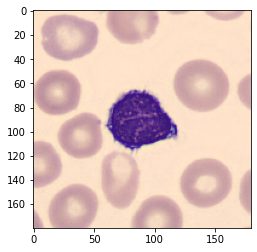

Prediction: lymphocyte


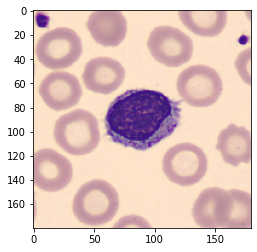

Prediction: lymphocyte


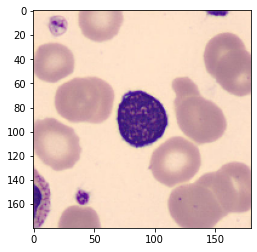

Prediction: lymphocyte


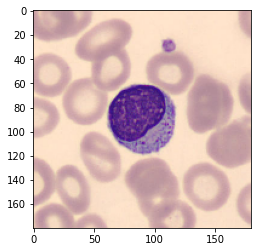

Prediction: lymphocyte


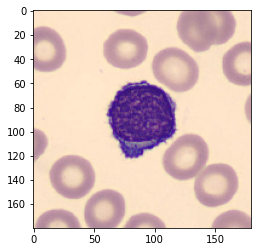

Prediction: lymphocyte


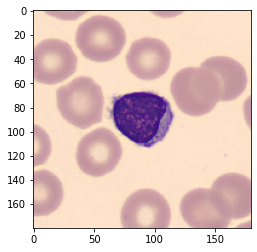

Prediction: lymphocyte


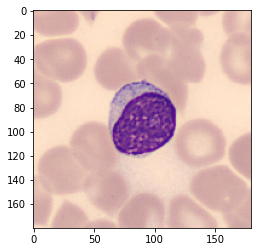

Prediction: monocyte


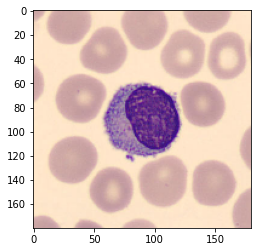

Prediction: lymphocyte


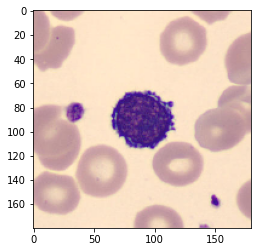

Prediction: lymphocyte


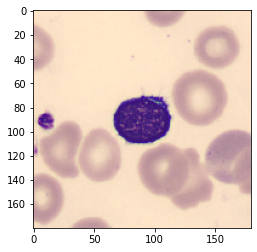

Prediction: lymphocyte


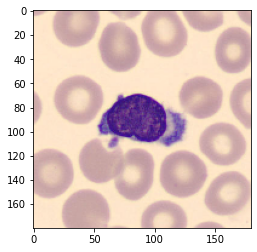

Prediction: lymphocyte


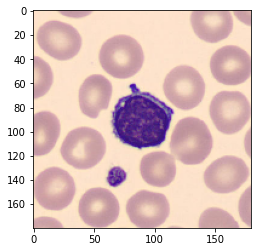

Prediction: lymphocyte


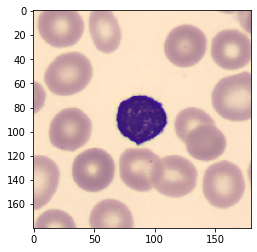

Prediction: lymphocyte


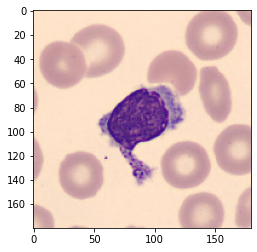

Prediction: lymphocyte


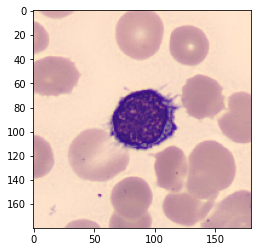

Prediction: lymphocyte


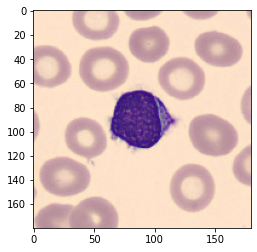

Prediction: lymphocyte


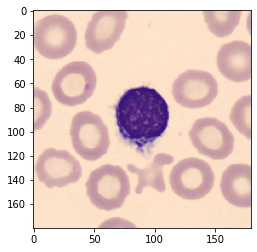

Prediction: lymphocyte


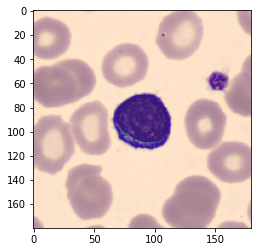

Prediction: lymphocyte


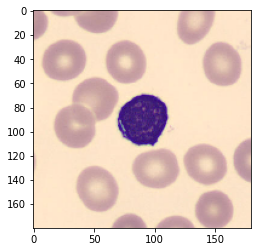

Prediction: lymphocyte


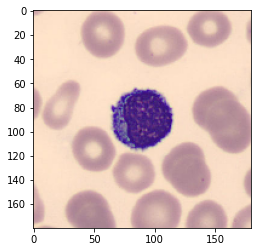

Prediction: lymphocyte


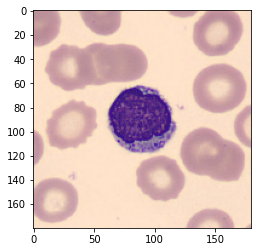

Prediction: lymphocyte


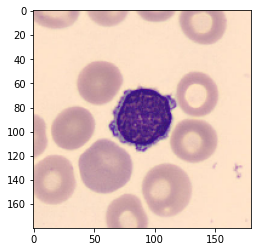

Prediction: lymphocyte


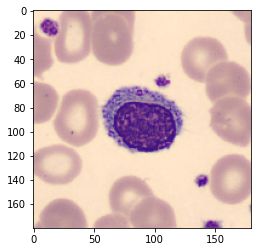

Prediction: monocyte


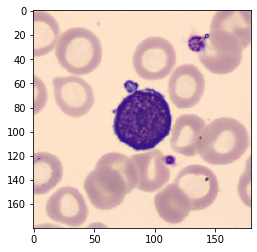

Prediction: lymphocyte


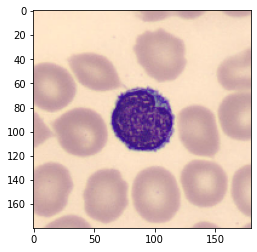

Prediction: lymphocyte


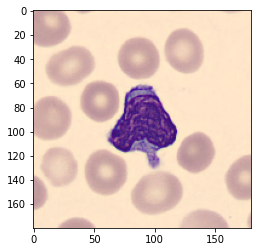

Prediction: lymphocyte


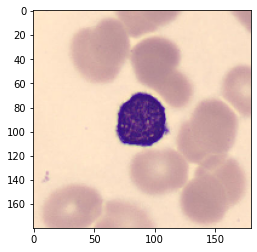

Prediction: lymphocyte


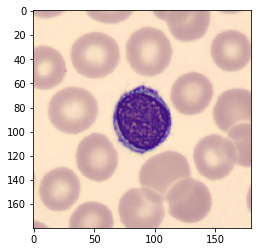

Prediction: lymphocyte
Basophil: 1
Eosinophil: 0
Lymphocyte: 96
Monocyte: 3
Neutrophil 0


In [ ]:
wbc_test(lymph_test)

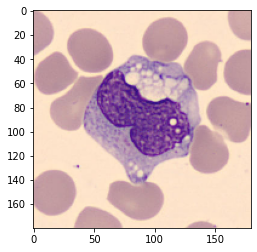

Prediction: monocyte


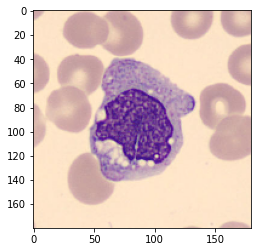

Prediction: monocyte


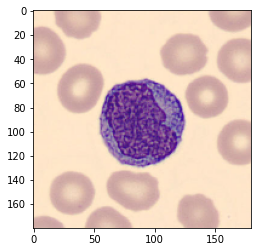

Prediction: monocyte


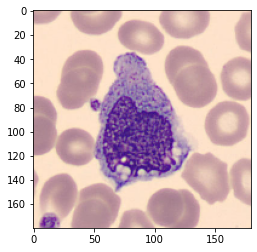

Prediction: monocyte


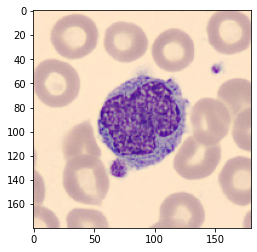

Prediction: monocyte


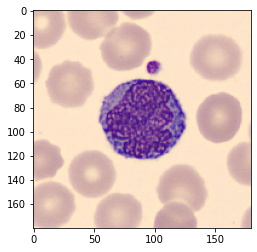

Prediction: monocyte


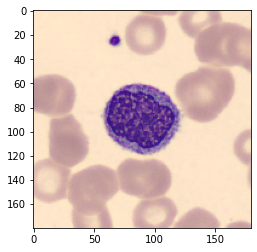

Prediction: lymphocyte


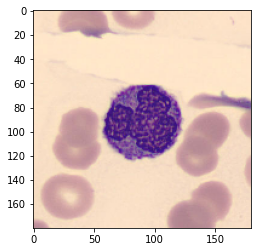

Prediction: monocyte


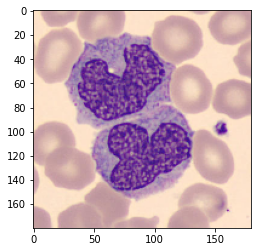

Prediction: monocyte


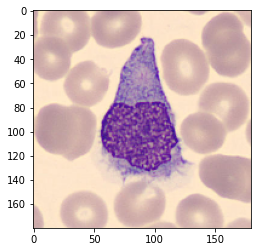

Prediction: monocyte


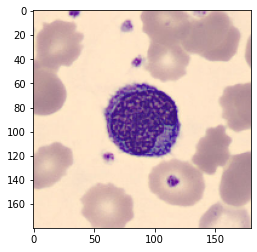

Prediction: monocyte


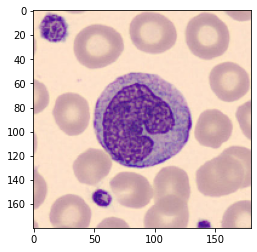

Prediction: monocyte


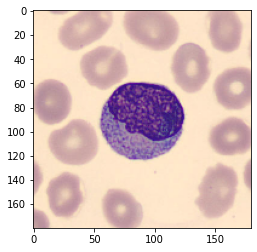

Prediction: monocyte


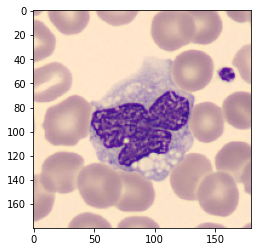

Prediction: basophil


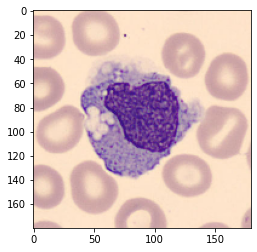

Prediction: monocyte


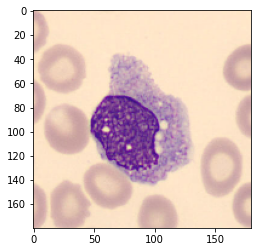

Prediction: monocyte


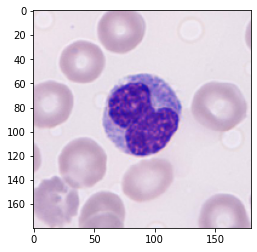

Prediction: basophil


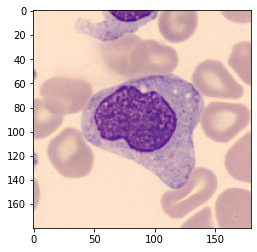

Prediction: monocyte


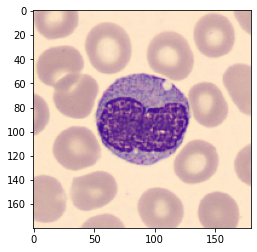

Prediction: monocyte


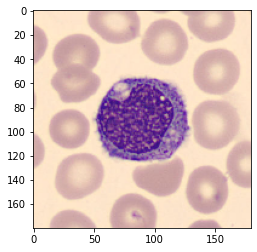

Prediction: monocyte


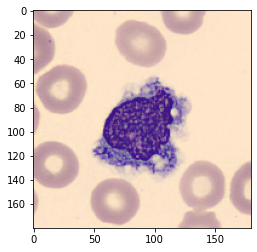

Prediction: monocyte


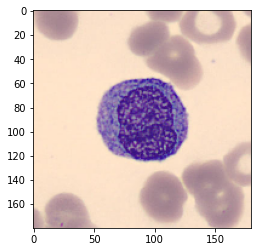

Prediction: monocyte


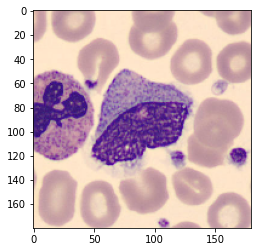

Prediction: monocyte


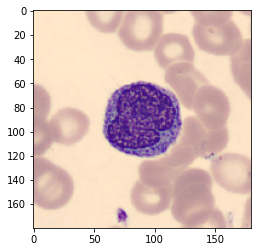

Prediction: monocyte


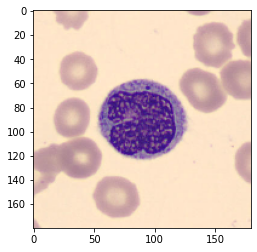

Prediction: monocyte


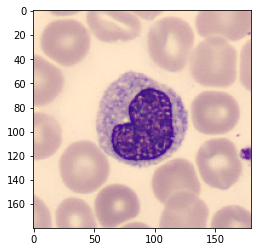

Prediction: monocyte


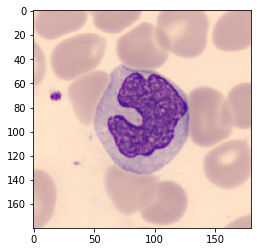

Prediction: monocyte


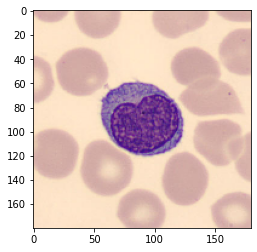

Prediction: monocyte


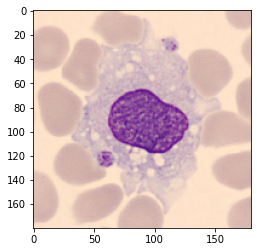

Prediction: monocyte


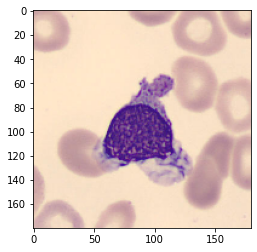

Prediction: monocyte


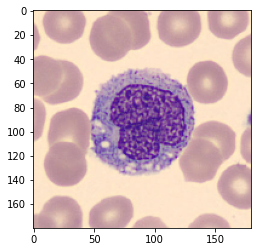

Prediction: monocyte


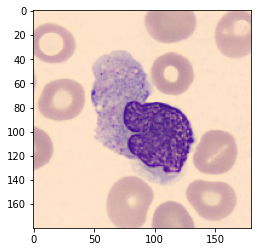

Prediction: monocyte


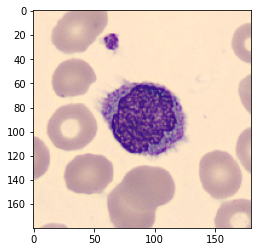

Prediction: monocyte


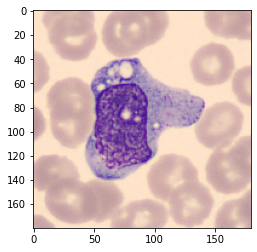

Prediction: monocyte


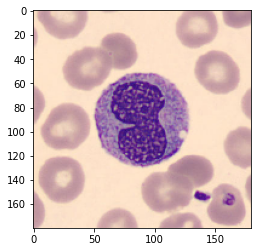

Prediction: monocyte


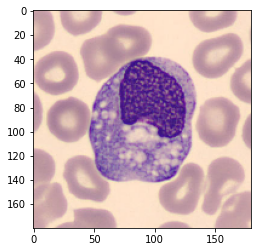

Prediction: monocyte


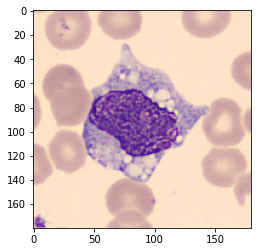

Prediction: monocyte


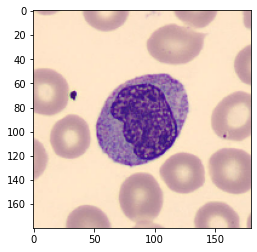

Prediction: monocyte


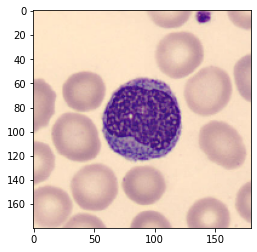

Prediction: monocyte


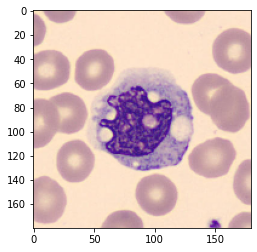

Prediction: monocyte


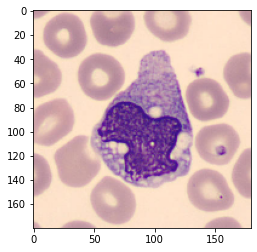

Prediction: monocyte


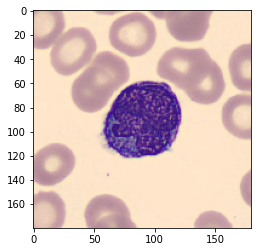

Prediction: basophil


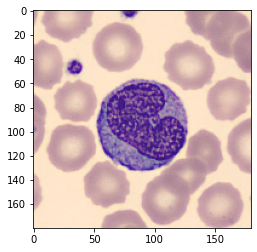

Prediction: monocyte


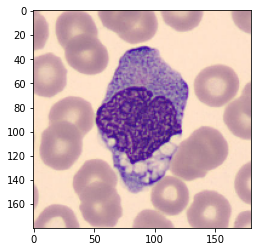

Prediction: monocyte


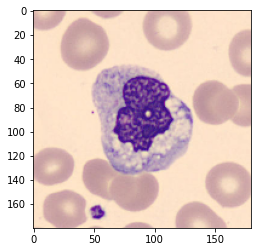

Prediction: neutrophil


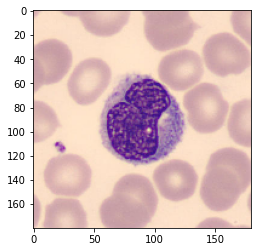

Prediction: monocyte


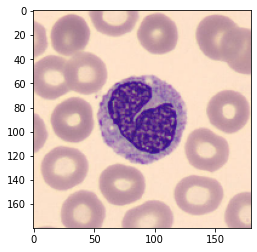

Prediction: monocyte


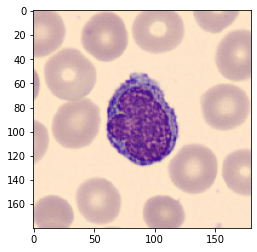

Prediction: monocyte


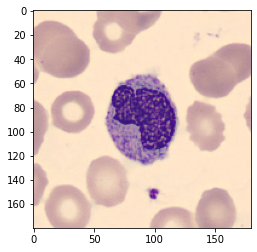

Prediction: monocyte


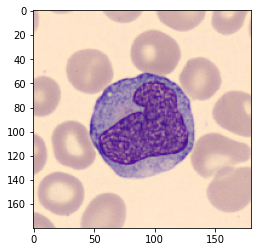

Prediction: monocyte


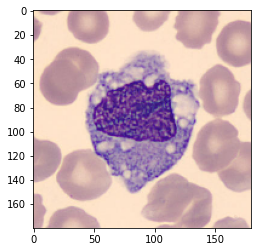

Prediction: monocyte


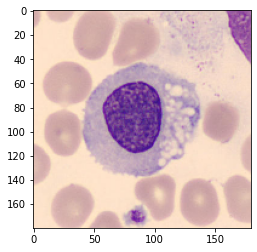

Prediction: monocyte


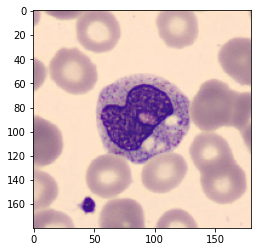

Prediction: monocyte


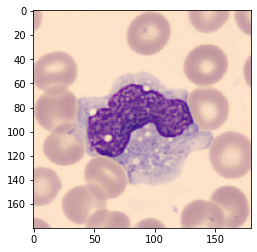

Prediction: monocyte


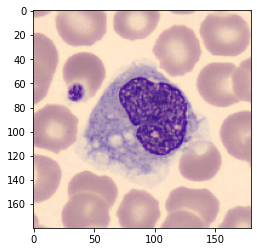

Prediction: monocyte


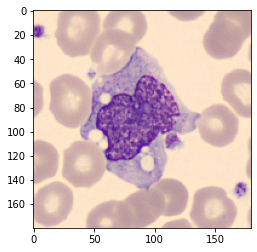

Prediction: monocyte


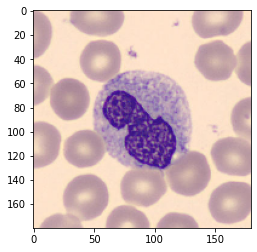

Prediction: monocyte


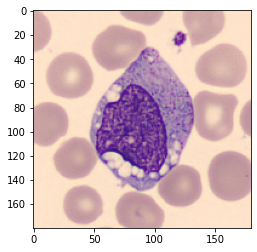

Prediction: monocyte


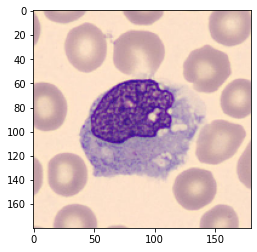

Prediction: monocyte


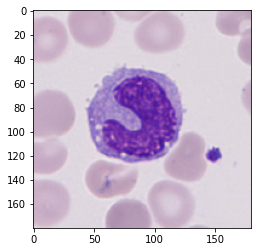

Prediction: monocyte


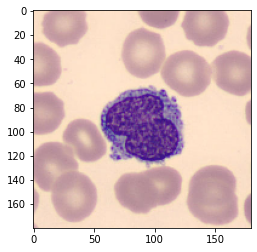

Prediction: monocyte


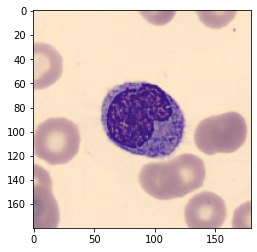

Prediction: monocyte


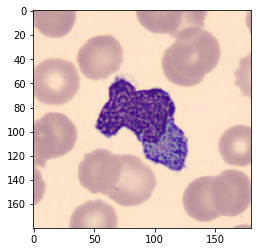

Prediction: basophil


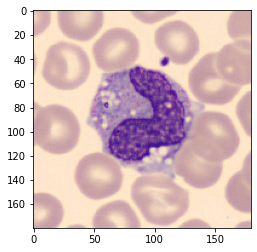

Prediction: monocyte


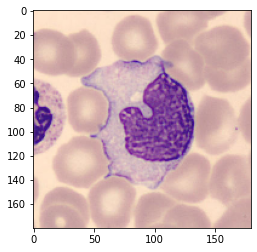

Prediction: monocyte


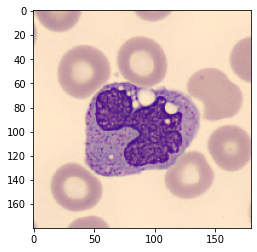

Prediction: monocyte


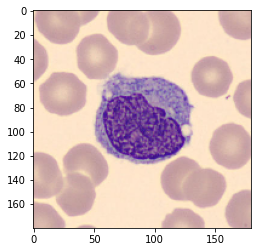

Prediction: monocyte


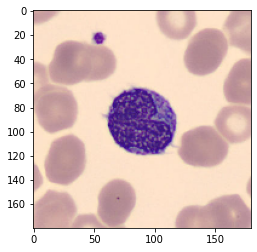

Prediction: lymphocyte


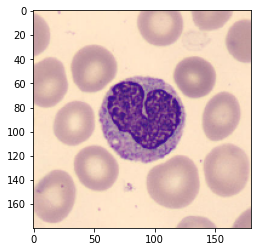

Prediction: basophil


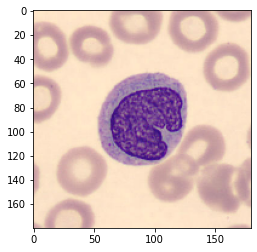

Prediction: monocyte


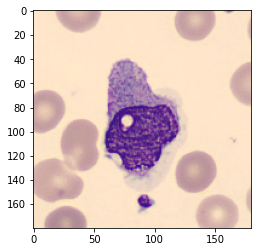

Prediction: monocyte


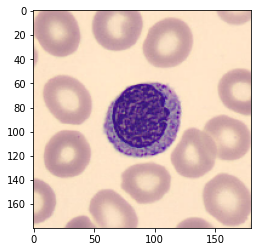

Prediction: monocyte


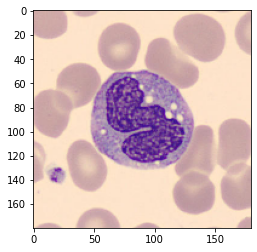

Prediction: monocyte


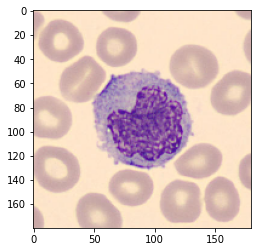

Prediction: monocyte


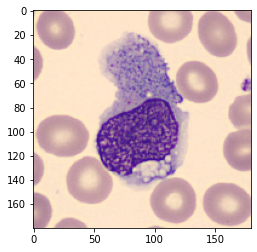

Prediction: monocyte


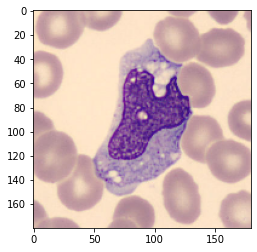

Prediction: monocyte


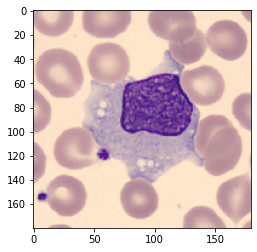

Prediction: monocyte


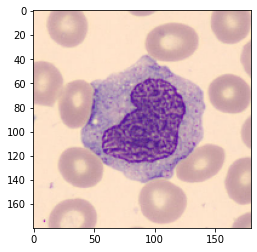

Prediction: monocyte


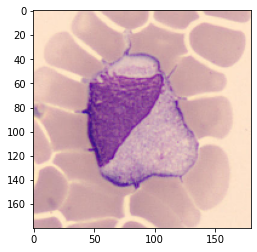

Prediction: monocyte


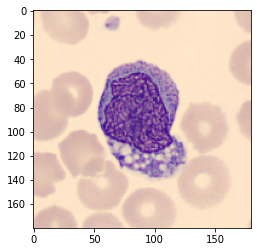

Prediction: monocyte


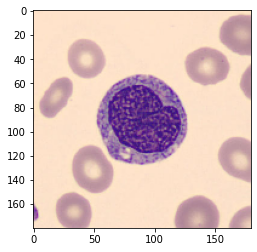

Prediction: monocyte


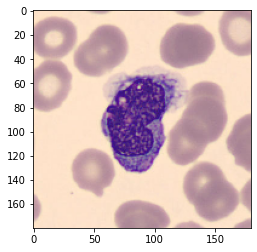

Prediction: monocyte


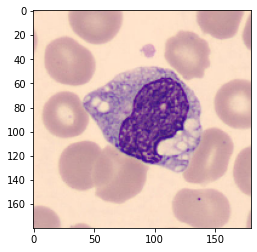

Prediction: monocyte


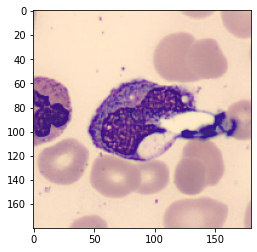

Prediction: eosinophil


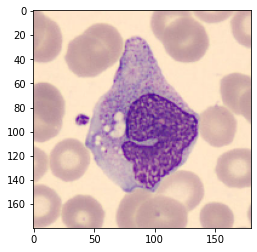

Prediction: monocyte


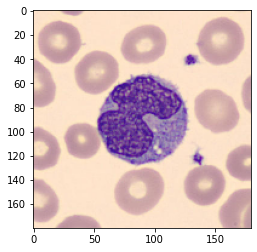

Prediction: monocyte


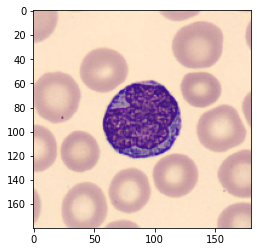

Prediction: monocyte


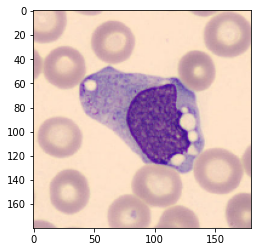

Prediction: monocyte


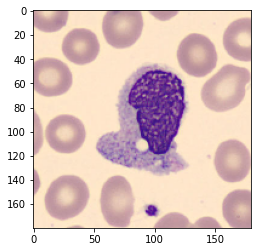

Prediction: monocyte


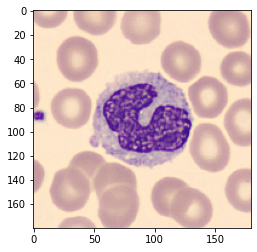

Prediction: monocyte


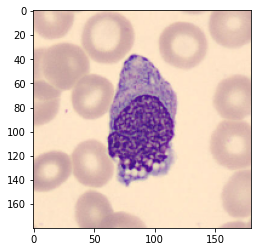

Prediction: monocyte


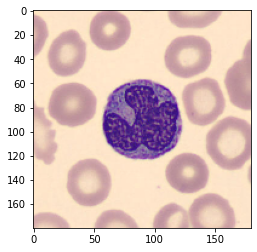

Prediction: monocyte


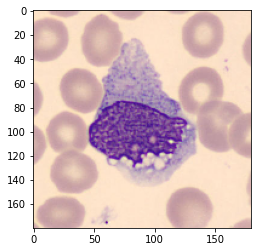

Prediction: monocyte


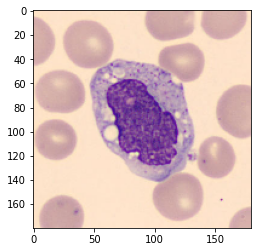

Prediction: monocyte


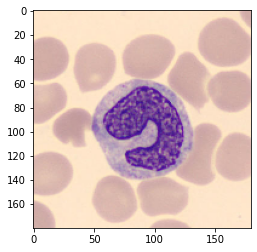

Prediction: monocyte


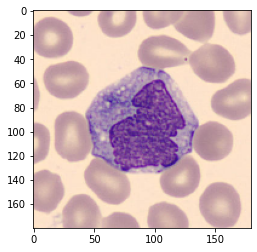

Prediction: monocyte


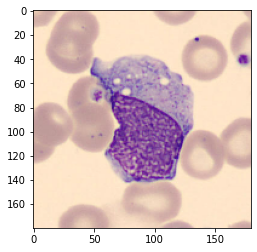

Prediction: monocyte


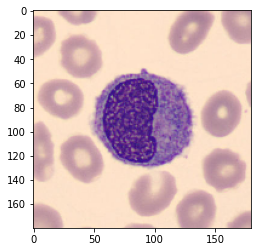

Prediction: monocyte


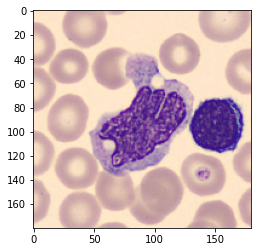

Prediction: basophil


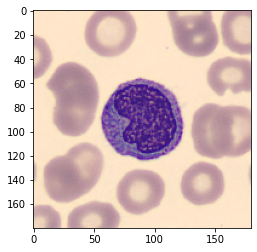

Prediction: monocyte
Basophil: 6
Eosinophil: 1
Lymphocyte: 2
Monocyte: 90
Neutrophil 1


In [ ]:
wbc_test(mono_test)

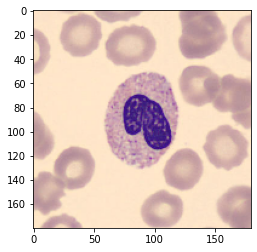

Prediction: neutrophil


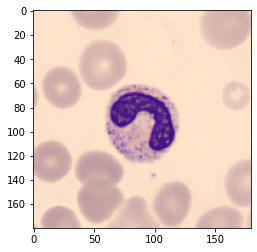

Prediction: neutrophil


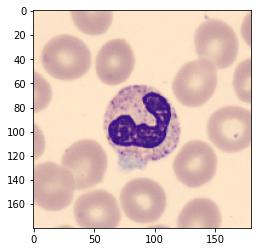

Prediction: neutrophil


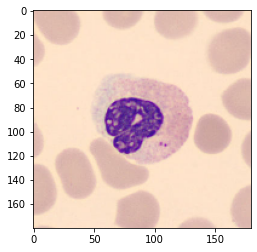

Prediction: neutrophil


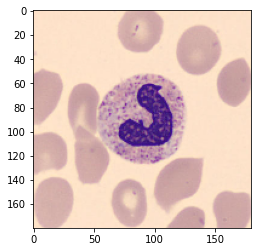

Prediction: neutrophil


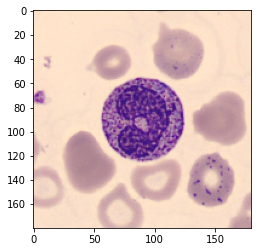

Prediction: basophil


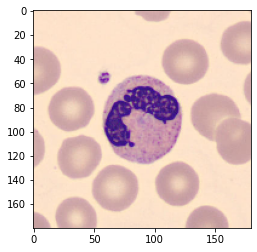

Prediction: neutrophil


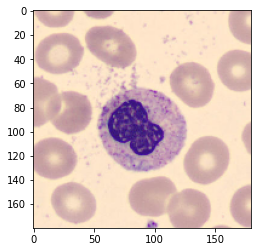

Prediction: neutrophil


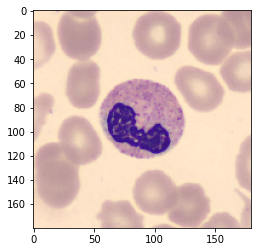

Prediction: neutrophil


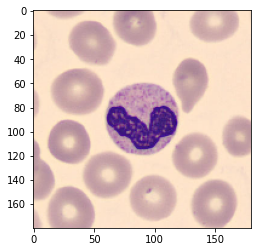

Prediction: neutrophil


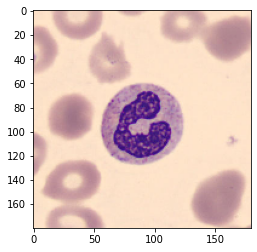

Prediction: neutrophil


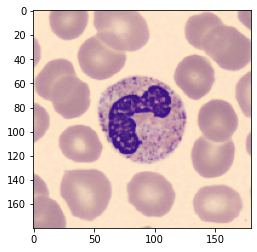

Prediction: neutrophil


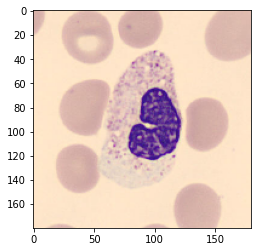

Prediction: neutrophil


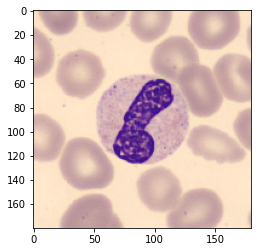

Prediction: neutrophil


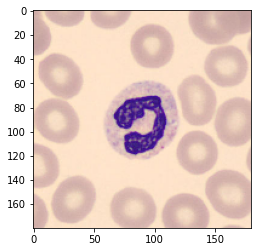

Prediction: neutrophil


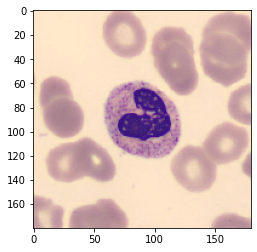

Prediction: neutrophil


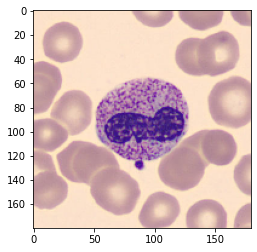

Prediction: neutrophil


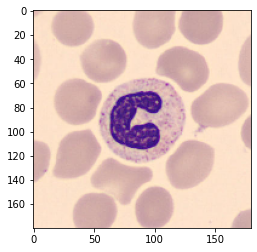

Prediction: neutrophil


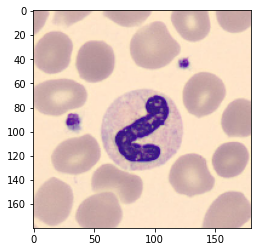

Prediction: neutrophil


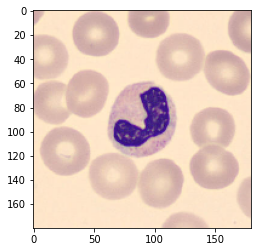

Prediction: neutrophil


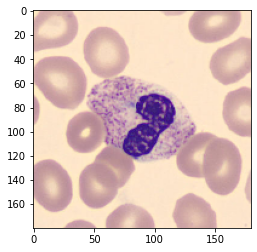

Prediction: neutrophil


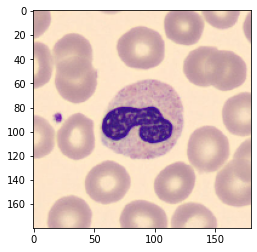

Prediction: neutrophil


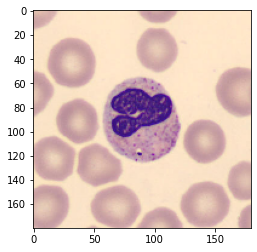

Prediction: neutrophil


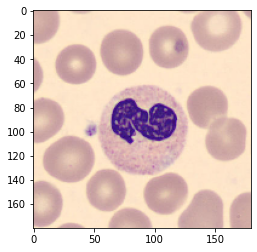

Prediction: neutrophil


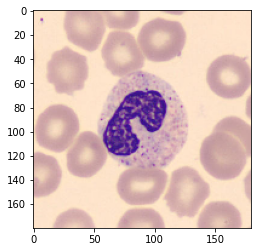

Prediction: neutrophil


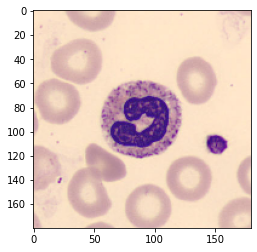

Prediction: neutrophil


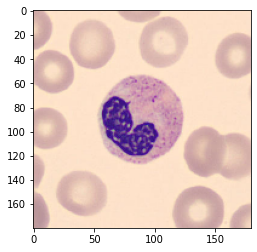

Prediction: neutrophil


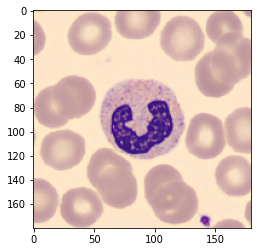

Prediction: neutrophil


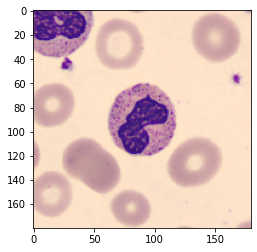

Prediction: neutrophil


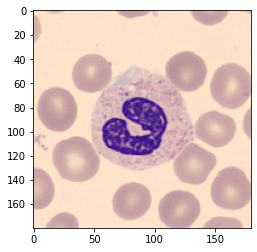

Prediction: neutrophil


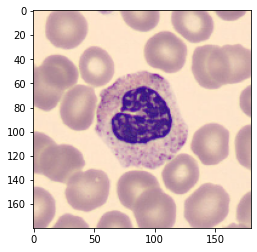

Prediction: neutrophil


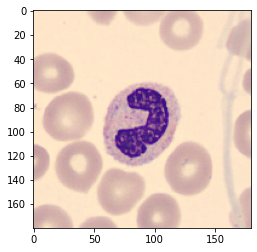

Prediction: neutrophil


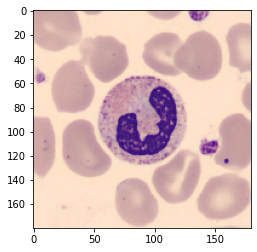

Prediction: neutrophil


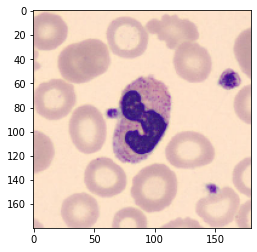

Prediction: neutrophil


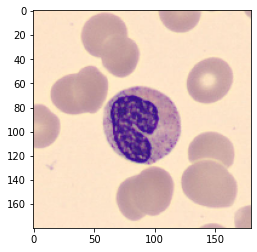

Prediction: neutrophil


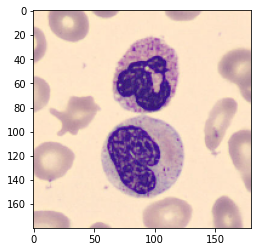

Prediction: neutrophil


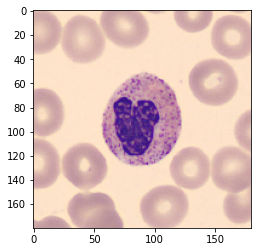

Prediction: neutrophil


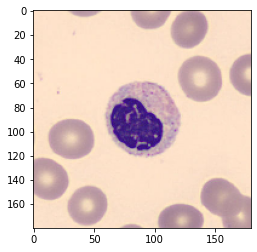

Prediction: neutrophil


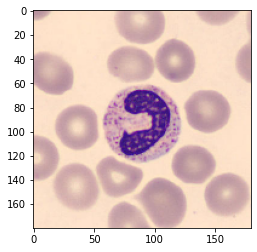

Prediction: neutrophil


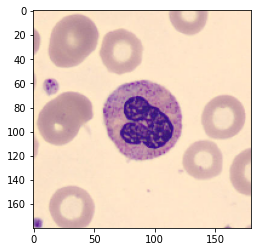

Prediction: neutrophil


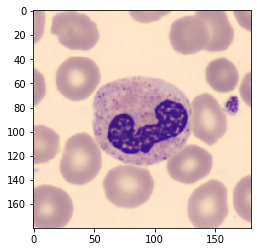

Prediction: neutrophil


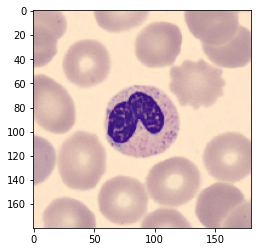

Prediction: neutrophil


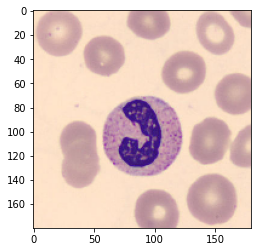

Prediction: neutrophil


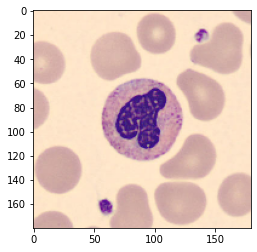

Prediction: neutrophil


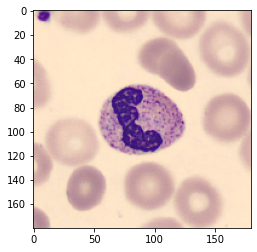

Prediction: neutrophil


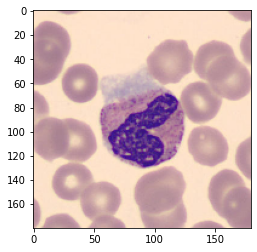

Prediction: neutrophil


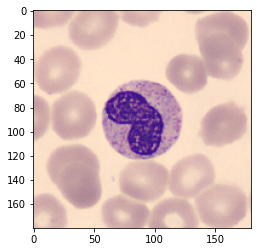

Prediction: neutrophil


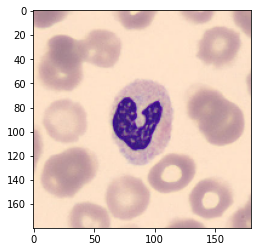

Prediction: neutrophil


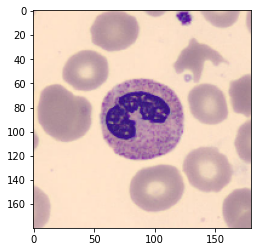

Prediction: neutrophil


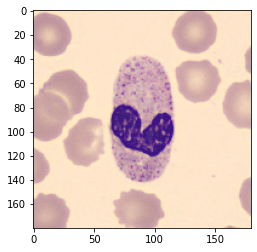

Prediction: neutrophil


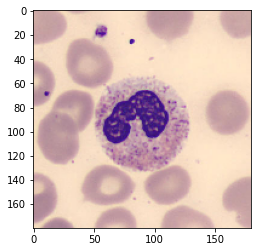

Prediction: neutrophil


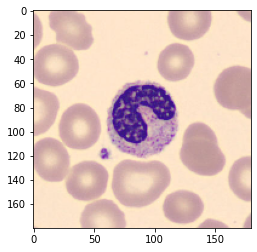

Prediction: neutrophil


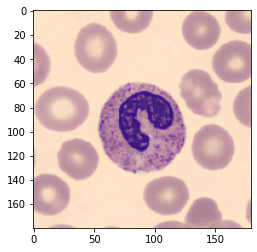

Prediction: neutrophil


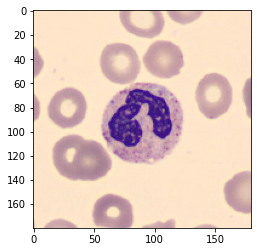

Prediction: neutrophil


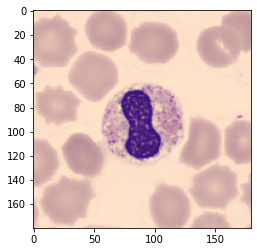

Prediction: neutrophil


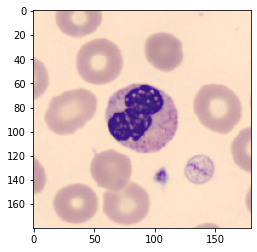

Prediction: neutrophil


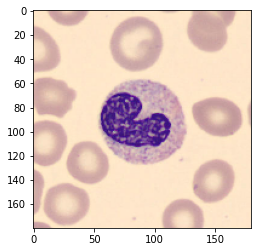

Prediction: neutrophil


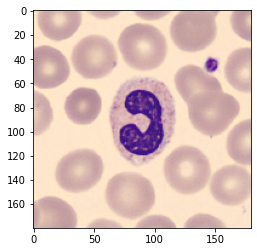

Prediction: neutrophil


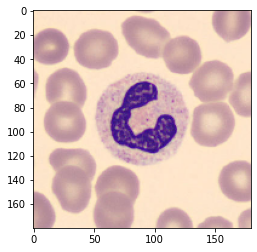

Prediction: neutrophil


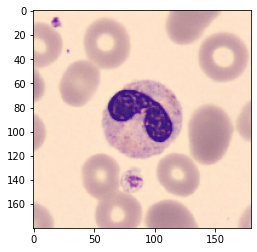

Prediction: neutrophil


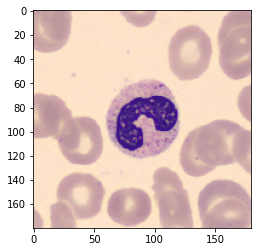

Prediction: neutrophil


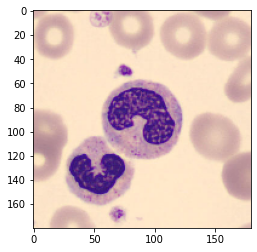

Prediction: neutrophil


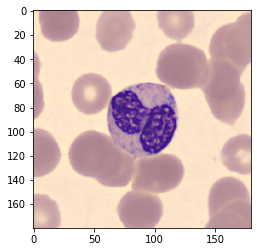

Prediction: neutrophil


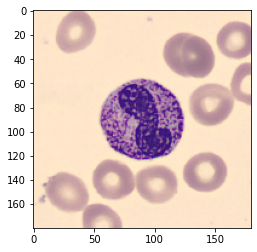

Prediction: basophil


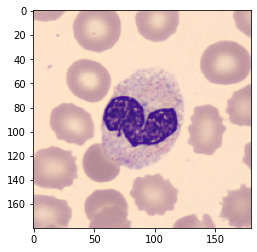

Prediction: neutrophil


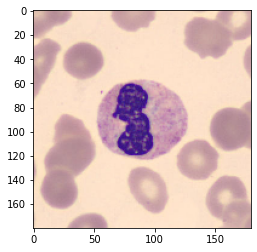

Prediction: neutrophil


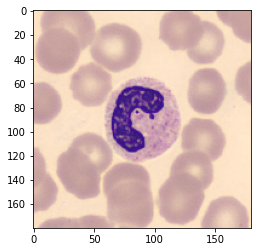

Prediction: neutrophil


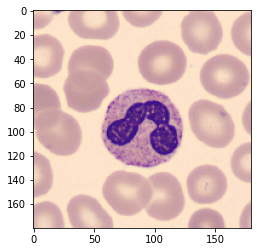

Prediction: neutrophil


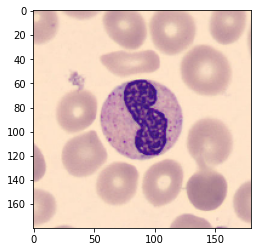

Prediction: neutrophil


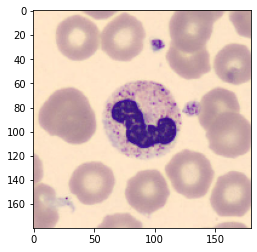

Prediction: neutrophil


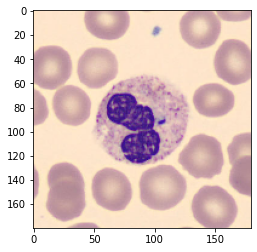

Prediction: neutrophil


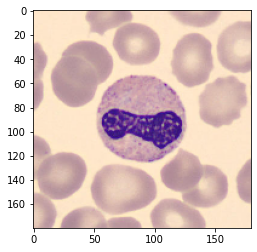

Prediction: neutrophil


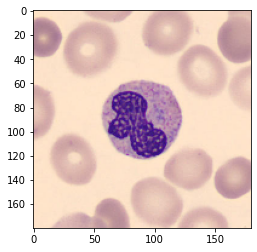

Prediction: neutrophil


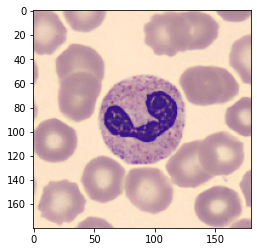

Prediction: neutrophil


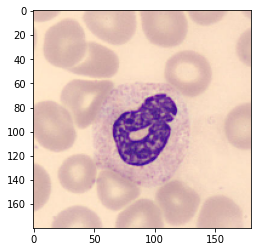

Prediction: neutrophil


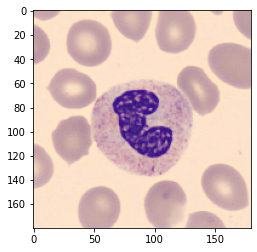

Prediction: neutrophil


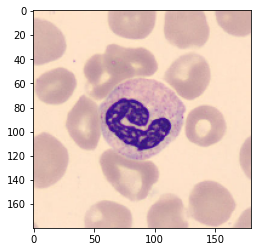

Prediction: neutrophil


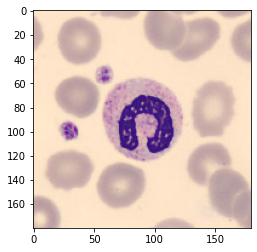

Prediction: neutrophil


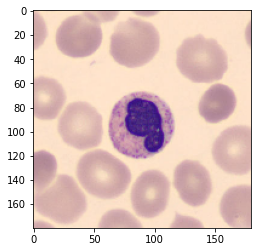

Prediction: neutrophil


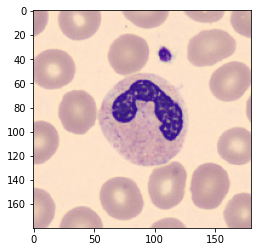

Prediction: neutrophil


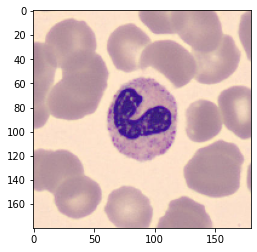

Prediction: neutrophil


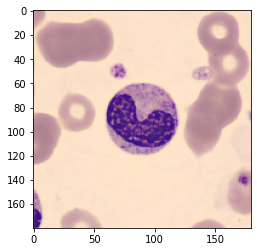

Prediction: neutrophil


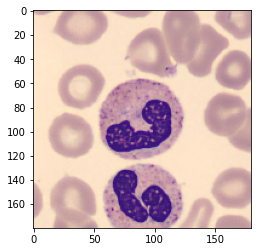

Prediction: neutrophil


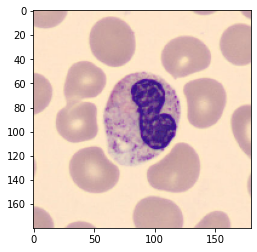

Prediction: neutrophil


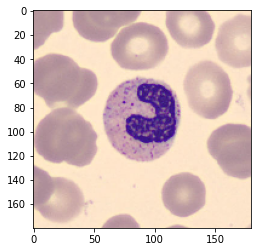

Prediction: neutrophil


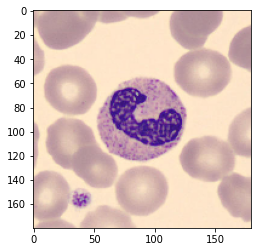

Prediction: neutrophil


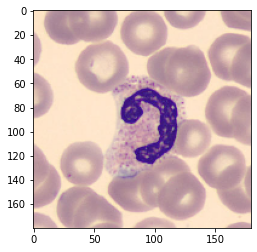

Prediction: neutrophil


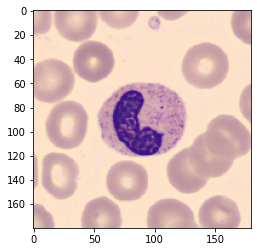

Prediction: neutrophil


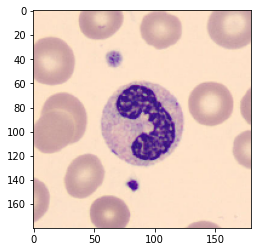

Prediction: neutrophil


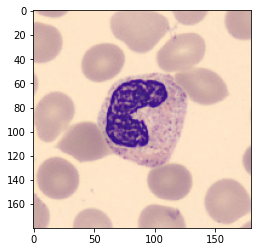

Prediction: neutrophil


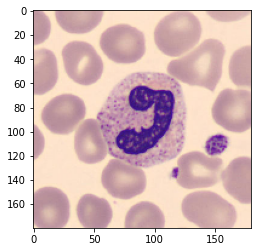

Prediction: neutrophil


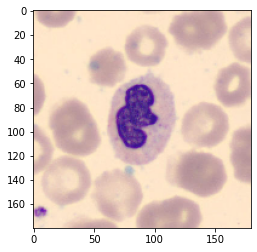

Prediction: neutrophil


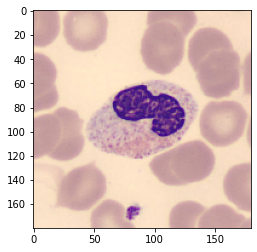

Prediction: neutrophil


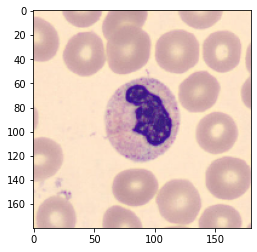

Prediction: neutrophil


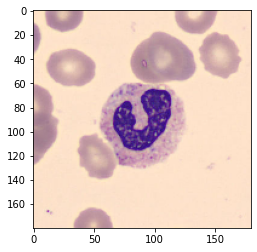

Prediction: neutrophil


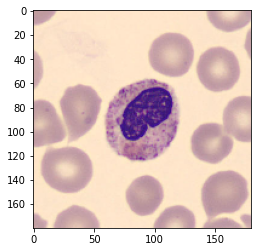

Prediction: eosinophil


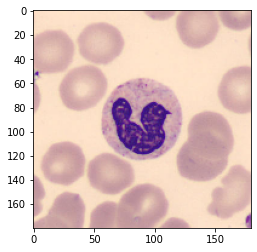

Prediction: neutrophil


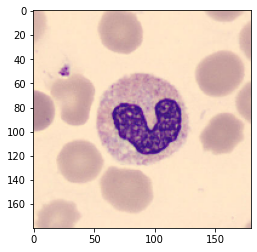

Prediction: neutrophil


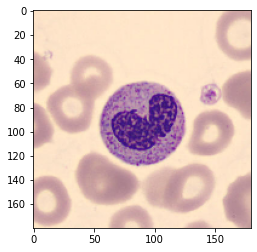

Prediction: neutrophil


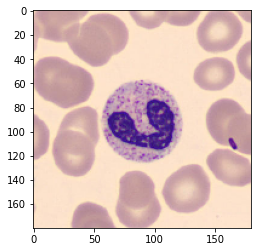

Prediction: neutrophil
Basophil: 2
Eosinophil: 1
Lymphocyte: 0
Monocyte: 0
Neutrophil 97


In [ ]:
wbc_test(neut_test)